# Network Architecture Exploration: Understanding Underfitting and Overfitting
## Background
This exercise aims to demonstrate how different neural network architectures can lead to underfitting or overfitting. You will experiment with various configurations of a fully connected neural network to observe these phenomena.

## Underfitting
Occurs when a model is too simple to capture the underlying pattern of the data. Often caused by having too few layers or neurons.

## Overfitting
Happens when a model learns the training data too well, including the noise, making it perform poorly on new, unseen data. This can result from having too many layers or neurons.

## Setup
Import the necessary libraries and prepare the dataset.

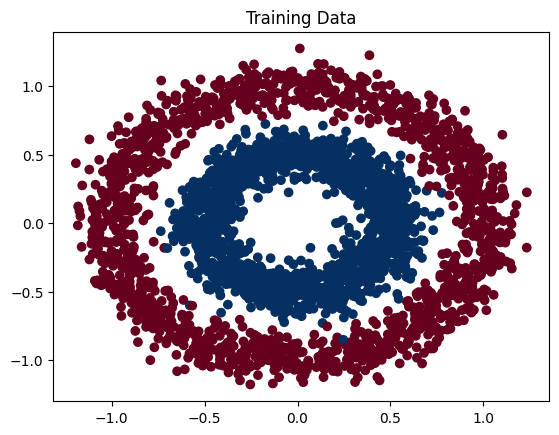

In [6]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.datasets import make_circles

# Generate synthetic data
X, y = make_circles(n_samples=6000, noise=0.09, factor=0.5, random_state=42)

# Splitting the dataset into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

# Visualize the dataset
plt.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap=plt.cm.RdBu)
plt.title("Training Data")
plt.show()

# Model Building
Define a function to create a model with a variable number of layers and neurons.

In [2]:
def build_model(num_layers=1, num_neurons=10, activation_function='sigmoid'):
    model = tf.keras.models.Sequential()
    
    model.add(tf.keras.layers.Dense(num_neurons, activation=activation_function, input_shape=(2,)))
    
    for _ in range(num_layers - 1):
        model.add(tf.keras.layers.Dense(num_neurons, activation=activation_function))
        
    model.add(tf.keras.layers.Dense(1, activation='sigmoid'))
    
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    
    return model


# Train and Evaluate Model Script
Below is a skeleton for a function to train and evaluate your models. Fill in the missing parts as indicated by the comments.

94/94 [==============================] - 0s 1ms/step


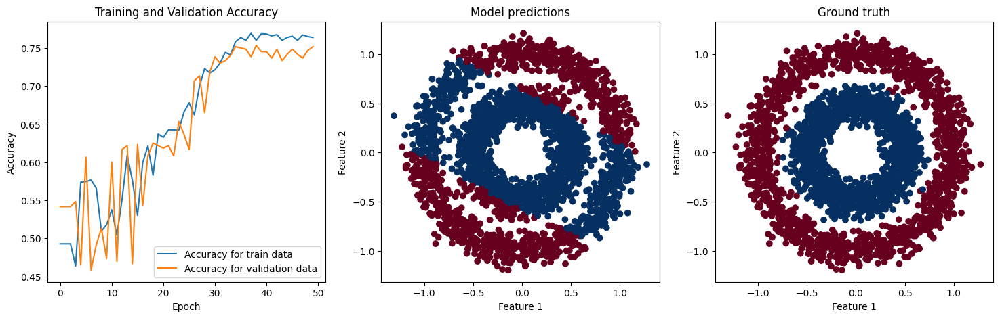

Test loss:  0.5566046833992004
Test accuracy:  0.7770000100135803
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_9 (Dense)             (None, 10)                30        
                                                                 
 dense_10 (Dense)            (None, 10)                110       
                                                                 
 dense_11 (Dense)            (None, 1)                 11        
                                                                 
Total params: 151 (604.00 Byte)
Trainable params: 151 (604.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None


In [9]:
def train_and_evaluate_model(model, epochs=50, plot=True):
    # Train the model
    history = model.fit(X_train, y_train, epochs=epochs, verbose=0, validation_split=0.2)

    # Evaluate the model on the test set
    # TASK: Fill in the evaluation code here
    test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=0)

    # Plotting (if enabled)
    if plot:
        plt.figure(figsize=(18, 5))
        plt.subplot(1, 3, 1)

        # Plot training and validation accuracy
        # TASK: Add code to plot training history
        plt.plot(history.history['accuracy'], label='Accuracy for train data')
        plt.plot(history.history['val_accuracy'], label='Accuracy for validation data')
        plt.title('Training and Validation Accuracy')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()

        model.predict(X_test) > 0.5
        # Plot model predictions vs. ground truth on the test set
        plt.subplot(1, 3, 2)
        plt.scatter(X_test[:, 0], X_test[:, 1], c=model.predict(X_test) > 0.5, cmap=plt.cm.RdBu)
        plt.title("Model predictions")
        plt.xlabel("Feature 1")
        plt.ylabel("Feature 2")
        
        # TASK: Add code to plot model predictions and ground truth
        plt.subplot(1, 3, 3)
        plt.scatter(X_test[:, 0], X_test[:, 1], c=y_test, cmap=plt.cm.RdBu)
        plt.title("Ground truth")
        plt.xlabel("Feature 1")
        plt.ylabel("Feature 2")

        plt.show()

    # TASK: Print or return any other metrics or plots you think are necessary
    print('Test loss: ', test_loss)
    print('Test accuracy: ', test_accuracy)
    print('Model summary: ', model.summary())


# Example of using the function with a specific architecture
model = build_model(num_layers=2, num_neurons=10)
train_and_evaluate_model(model, epochs=50)


# Experimentation
## Task 1: Underfitting
1. Create and train a model with very few layers and/or neurons (e.g., 1 layer with 5 neurons).
2. Evaluate Performance:
    * Plot training and validation accuracy over epochs.
    * Plot model predictions vs. ground truth on the test data.
    * Analyze if the model's performance is poor on both training and test data, which indicates underfitting.
## Task 2: Overfitting
1. Create a model with an excessive number of layers and/or neurons (e.g., 5 layers with 100 neurons each) and increased number of epochs.
2. Evaluate Performance:
    * Observe the training and validation accuracy plots for a wide gap, indicating overfitting.
    * Compare model predictions with ground truth for the test data.
    * Look for high training accuracy but poor test accuracy.
## Task 3: Balanced Model
1. Experiment to find a balanced architecture.
2. Evaluate Performance:
    * Ensure the training and validation accuracy are both high and close to each other.
    * The model's predictions should closely match the ground truth for the test data.
    * The model should not show signs of significant underfitting or overfitting.

94/94 [==============================] - 0s 983us/step


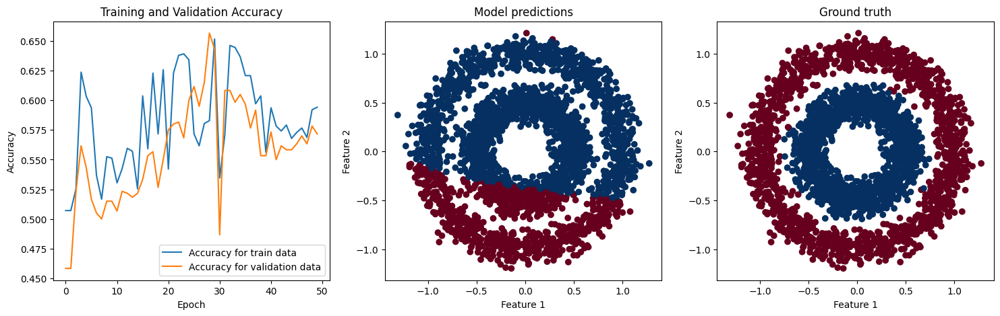

Test loss:  0.676353394985199
Test accuracy:  0.5916666388511658
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_12 (Dense)            (None, 5)                 15        
                                                                 
 dense_13 (Dense)            (None, 1)                 6         
                                                                 
Total params: 21 (84.00 Byte)
Trainable params: 21 (84.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None


In [10]:
# task 1
model = build_model(num_layers=1, num_neurons=5)
train_and_evaluate_model(model, epochs=50)

94/94 [==============================] - 0s 1ms/step


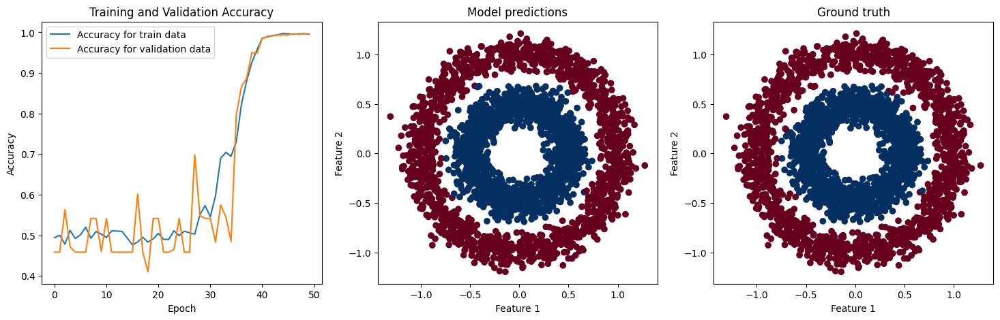

Test loss:  0.06902284920215607
Test accuracy:  0.9956666827201843
Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_14 (Dense)            (None, 100)               300       
                                                                 
 dense_15 (Dense)            (None, 100)               10100     
                                                                 
 dense_16 (Dense)            (None, 1)                 101       
                                                                 
Total params: 10501 (41.02 KB)
Trainable params: 10501 (41.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None


In [11]:
#test 2
model = build_model(num_layers=2, num_neurons=100)
train_and_evaluate_model(model, epochs=50)

Number of neurons:  20
Number of layers:  1
Number of epochs:  10
94/94 [==============================] - 0s 995us/step


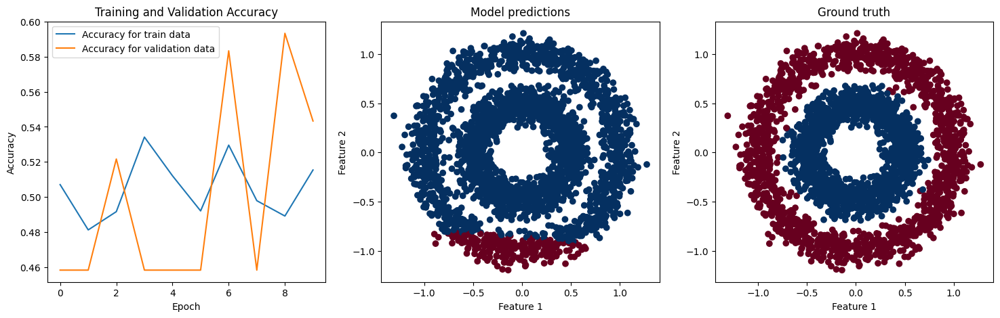

Test loss:  0.6932907700538635
Test accuracy:  0.5766666531562805
Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_84 (Dense)            (None, 20)                60        
                                                                 
 dense_85 (Dense)            (None, 1)                 21        
                                                                 
Total params: 81 (324.00 Byte)
Trainable params: 81 (324.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
Number of layers:  1
Number of epochs:  50
94/94 [==============================] - 0s 1ms/step


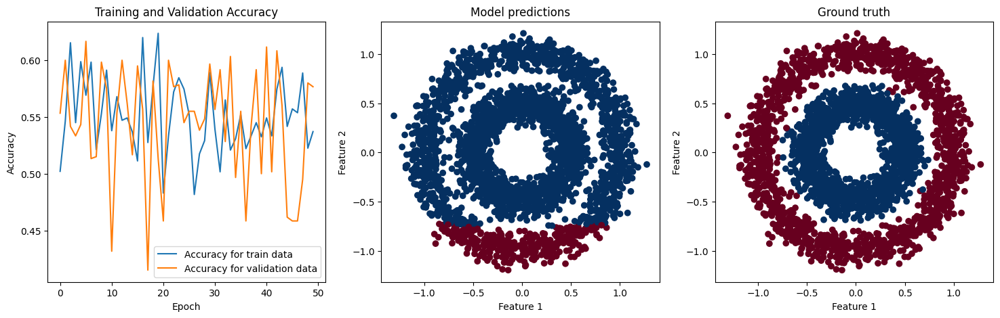

Test loss:  0.6912634372711182
Test accuracy:  0.6113333106040955
Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_86 (Dense)            (None, 20)                60        
                                                                 
 dense_87 (Dense)            (None, 1)                 21        
                                                                 
Total params: 81 (324.00 Byte)
Trainable params: 81 (324.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
Number of layers:  1
Number of epochs:  100
94/94 [==============================] - 0s 988us/step


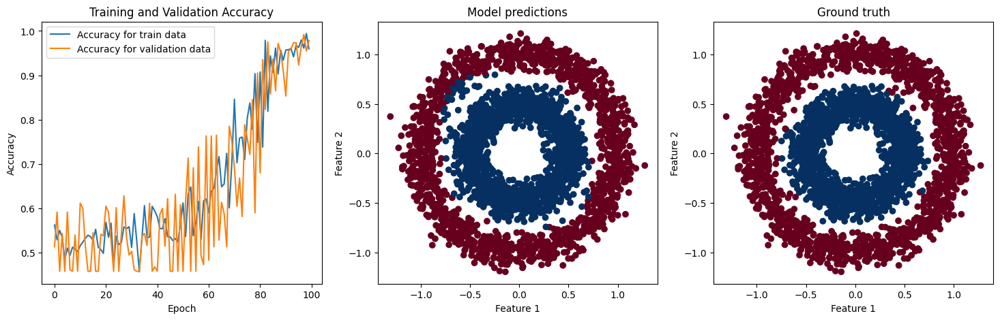

Test loss:  0.5795698165893555
Test accuracy:  0.9826666712760925
Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_88 (Dense)            (None, 20)                60        
                                                                 
 dense_89 (Dense)            (None, 1)                 21        
                                                                 
Total params: 81 (324.00 Byte)
Trainable params: 81 (324.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
Number of layers:  2
Number of epochs:  10
94/94 [==============================] - 0s 1ms/step


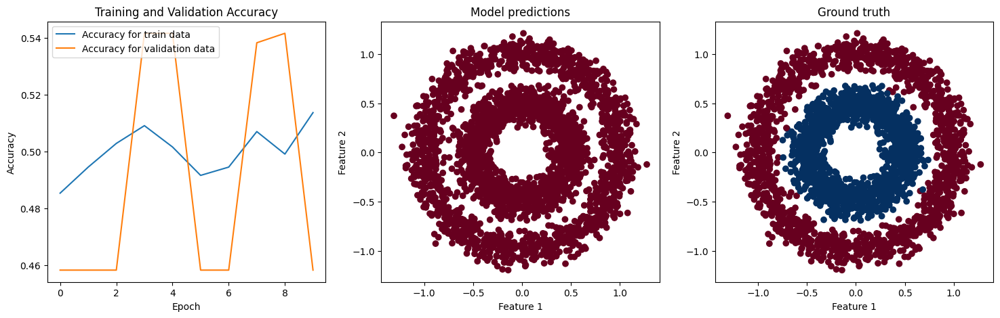

Test loss:  0.69327712059021
Test accuracy:  0.5026666522026062
Model: "sequential_36"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_90 (Dense)            (None, 20)                60        
                                                                 
 dense_91 (Dense)            (None, 20)                420       
                                                                 
 dense_92 (Dense)            (None, 1)                 21        
                                                                 
Total params: 501 (1.96 KB)
Trainable params: 501 (1.96 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
Number of layers:  2
Number of epochs:  50
94/94 [==============================] - 0s 1ms/step


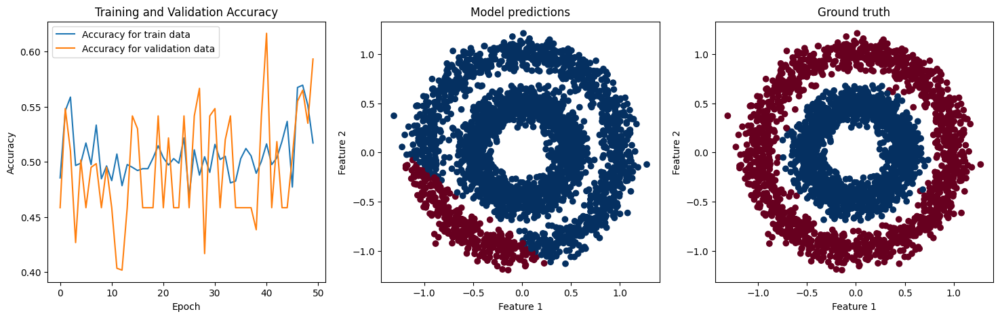

Test loss:  0.6915642023086548
Test accuracy:  0.6153333187103271
Model: "sequential_37"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_93 (Dense)            (None, 20)                60        
                                                                 
 dense_94 (Dense)            (None, 20)                420       
                                                                 
 dense_95 (Dense)            (None, 1)                 21        
                                                                 
Total params: 501 (1.96 KB)
Trainable params: 501 (1.96 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
Number of layers:  2
Number of epochs:  100
94/94 [==============================] - 0s 1ms/step


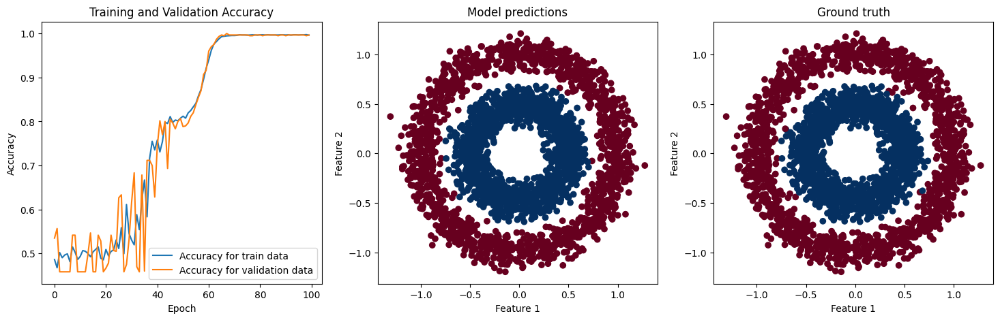

Test loss:  0.023213857784867287
Test accuracy:  0.9973333477973938
Model: "sequential_38"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_96 (Dense)            (None, 20)                60        
                                                                 
 dense_97 (Dense)            (None, 20)                420       
                                                                 
 dense_98 (Dense)            (None, 1)                 21        
                                                                 
Total params: 501 (1.96 KB)
Trainable params: 501 (1.96 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
Number of layers:  3
Number of epochs:  10
94/94 [==============================] - 0s 1ms/step


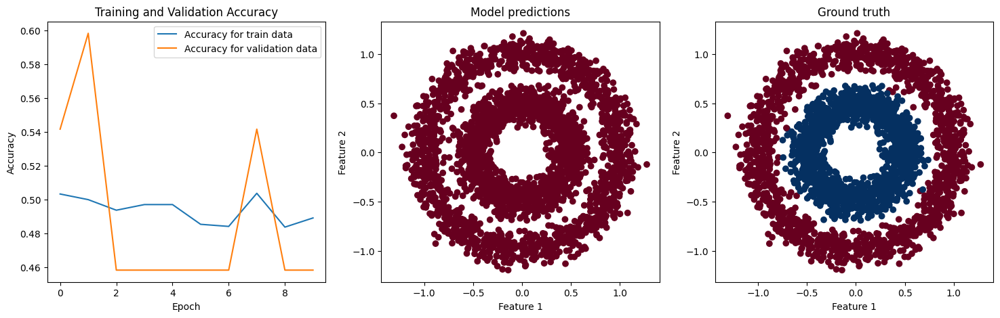

Test loss:  0.6932007670402527
Test accuracy:  0.5026666522026062
Model: "sequential_39"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_99 (Dense)            (None, 20)                60        
                                                                 
 dense_100 (Dense)           (None, 20)                420       
                                                                 
 dense_101 (Dense)           (None, 20)                420       
                                                                 
 dense_102 (Dense)           (None, 1)                 21        
                                                                 
Total params: 921 (3.60 KB)
Trainable params: 921 (3.60 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
Nu

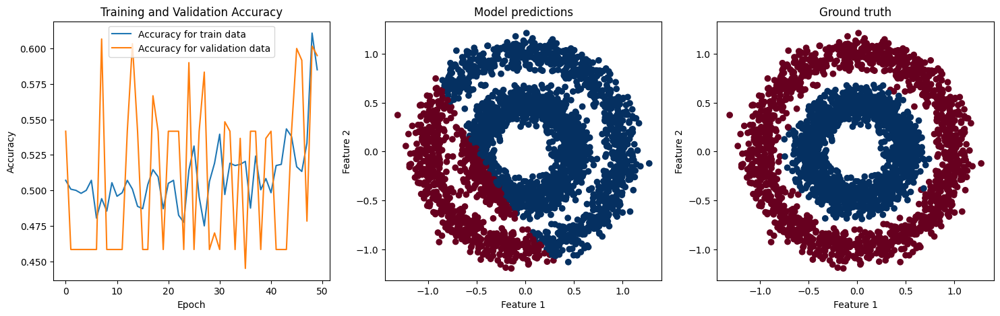

Test loss:  0.6844950914382935
Test accuracy:  0.593999981880188
Model: "sequential_40"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_103 (Dense)           (None, 20)                60        
                                                                 
 dense_104 (Dense)           (None, 20)                420       
                                                                 
 dense_105 (Dense)           (None, 20)                420       
                                                                 
 dense_106 (Dense)           (None, 1)                 21        
                                                                 
Total params: 921 (3.60 KB)
Trainable params: 921 (3.60 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
Num

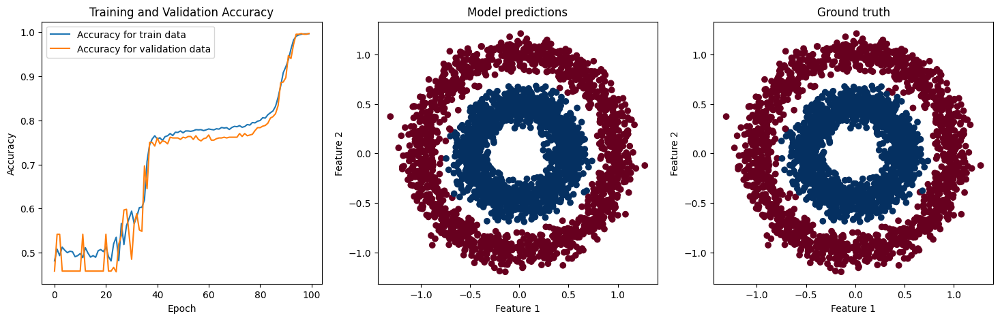

Test loss:  0.06373539566993713
Test accuracy:  0.9973333477973938
Model: "sequential_41"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_107 (Dense)           (None, 20)                60        
                                                                 
 dense_108 (Dense)           (None, 20)                420       
                                                                 
 dense_109 (Dense)           (None, 20)                420       
                                                                 
 dense_110 (Dense)           (None, 1)                 21        
                                                                 
Total params: 921 (3.60 KB)
Trainable params: 921 (3.60 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
N

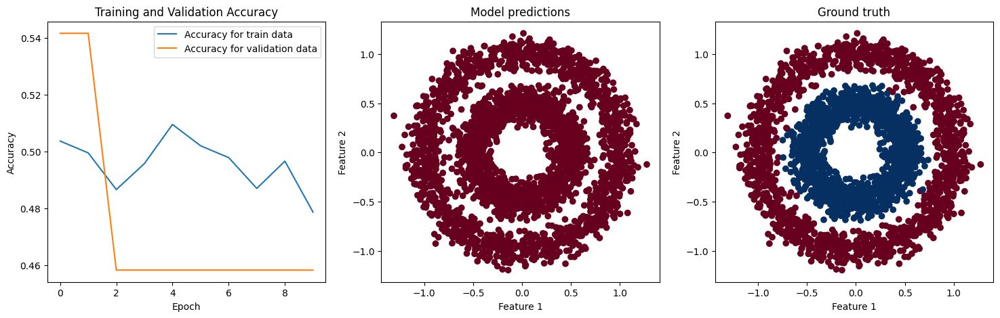

Test loss:  0.6937444806098938
Test accuracy:  0.5026666522026062
Model: "sequential_42"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_111 (Dense)           (None, 20)                60        
                                                                 
 dense_112 (Dense)           (None, 20)                420       
                                                                 
 dense_113 (Dense)           (None, 20)                420       
                                                                 
 dense_114 (Dense)           (None, 20)                420       
                                                                 
 dense_115 (Dense)           (None, 1)                 21        
                                                                 
Total params: 1341 (5.24 KB)
Trainable params: 1341 (5.24 KB)
Non-trainable params: 0 (0.00 Byte)
_____________________

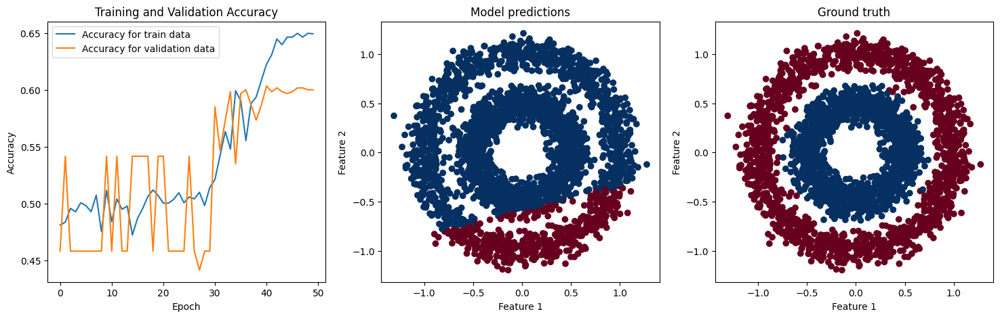

Test loss:  0.6045777797698975
Test accuracy:  0.6309999823570251
Model: "sequential_43"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_116 (Dense)           (None, 20)                60        
                                                                 
 dense_117 (Dense)           (None, 20)                420       
                                                                 
 dense_118 (Dense)           (None, 20)                420       
                                                                 
 dense_119 (Dense)           (None, 20)                420       
                                                                 
 dense_120 (Dense)           (None, 1)                 21        
                                                                 
Total params: 1341 (5.24 KB)
Trainable params: 1341 (5.24 KB)
Non-trainable params: 0 (0.00 Byte)
_____________________

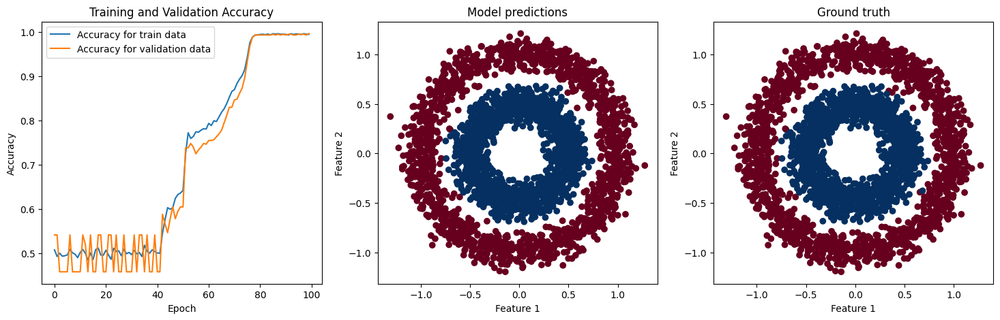

Test loss:  0.013907956890761852
Test accuracy:  0.9983333349227905
Model: "sequential_44"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_121 (Dense)           (None, 20)                60        
                                                                 
 dense_122 (Dense)           (None, 20)                420       
                                                                 
 dense_123 (Dense)           (None, 20)                420       
                                                                 
 dense_124 (Dense)           (None, 20)                420       
                                                                 
 dense_125 (Dense)           (None, 1)                 21        
                                                                 
Total params: 1341 (5.24 KB)
Trainable params: 1341 (5.24 KB)
Non-trainable params: 0 (0.00 Byte)
___________________

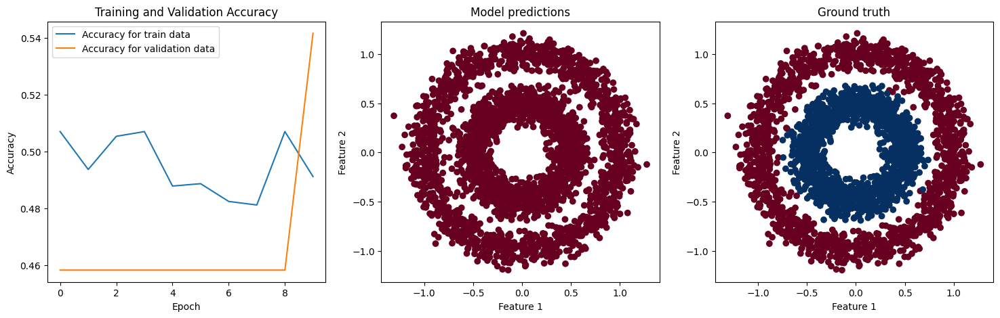

Test loss:  0.693170964717865
Test accuracy:  0.4973333477973938
Model: "sequential_45"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_126 (Dense)           (None, 20)                60        
                                                                 
 dense_127 (Dense)           (None, 20)                420       
                                                                 
 dense_128 (Dense)           (None, 20)                420       
                                                                 
 dense_129 (Dense)           (None, 20)                420       
                                                                 
 dense_130 (Dense)           (None, 20)                420       
                                                                 
 dense_131 (Dense)           (None, 1)                 21        
                                                      

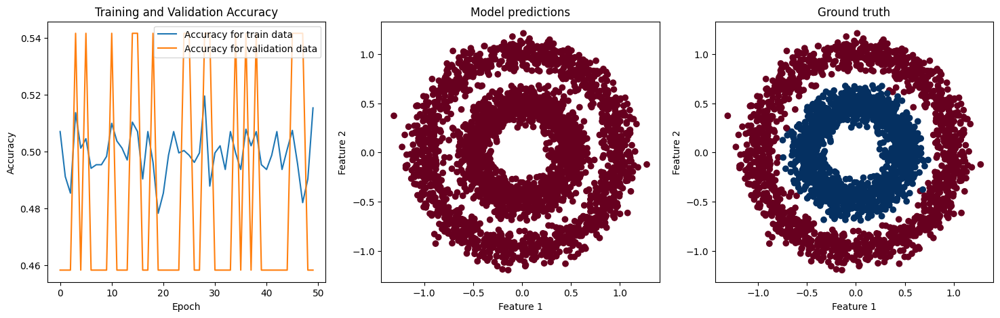

Test loss:  0.6931363940238953
Test accuracy:  0.5026666522026062
Model: "sequential_46"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_132 (Dense)           (None, 20)                60        
                                                                 
 dense_133 (Dense)           (None, 20)                420       
                                                                 
 dense_134 (Dense)           (None, 20)                420       
                                                                 
 dense_135 (Dense)           (None, 20)                420       
                                                                 
 dense_136 (Dense)           (None, 20)                420       
                                                                 
 dense_137 (Dense)           (None, 1)                 21        
                                                     

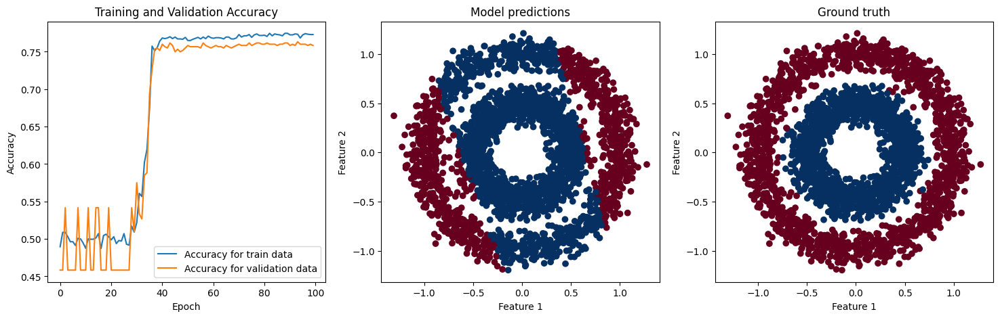

Test loss:  0.4575748145580292
Test accuracy:  0.7763333320617676
Model: "sequential_47"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_138 (Dense)           (None, 20)                60        
                                                                 
 dense_139 (Dense)           (None, 20)                420       
                                                                 
 dense_140 (Dense)           (None, 20)                420       
                                                                 
 dense_141 (Dense)           (None, 20)                420       
                                                                 
 dense_142 (Dense)           (None, 20)                420       
                                                                 
 dense_143 (Dense)           (None, 1)                 21        
                                                     

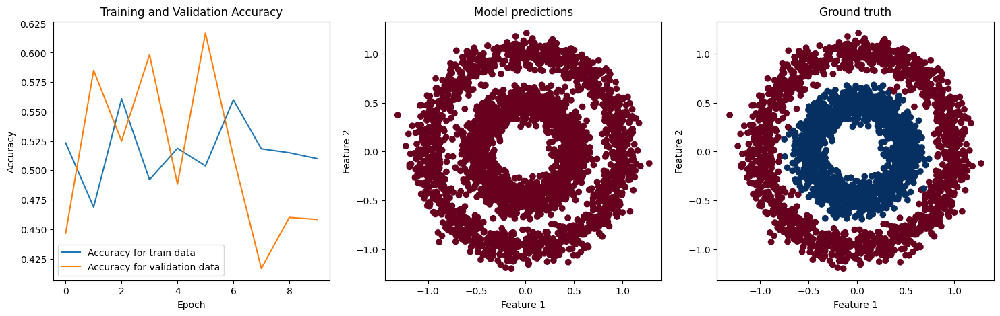

Test loss:  0.6937347054481506
Test accuracy:  0.5026666522026062
Model: "sequential_48"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_144 (Dense)           (None, 50)                150       
                                                                 
 dense_145 (Dense)           (None, 1)                 51        
                                                                 
Total params: 201 (804.00 Byte)
Trainable params: 201 (804.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  50
Number of layers:  1
Number of epochs:  50
94/94 [==============================] - 0s 1ms/step


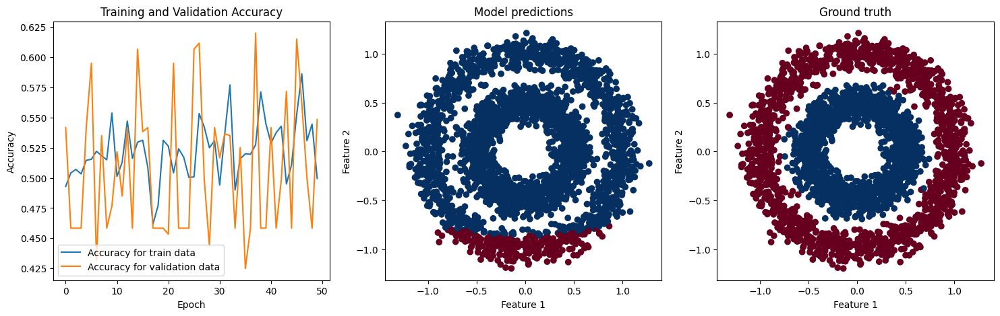

Test loss:  0.6917961239814758
Test accuracy:  0.5856666564941406
Model: "sequential_49"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_146 (Dense)           (None, 50)                150       
                                                                 
 dense_147 (Dense)           (None, 1)                 51        
                                                                 
Total params: 201 (804.00 Byte)
Trainable params: 201 (804.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  50
Number of layers:  1
Number of epochs:  100
94/94 [==============================] - 0s 1ms/step


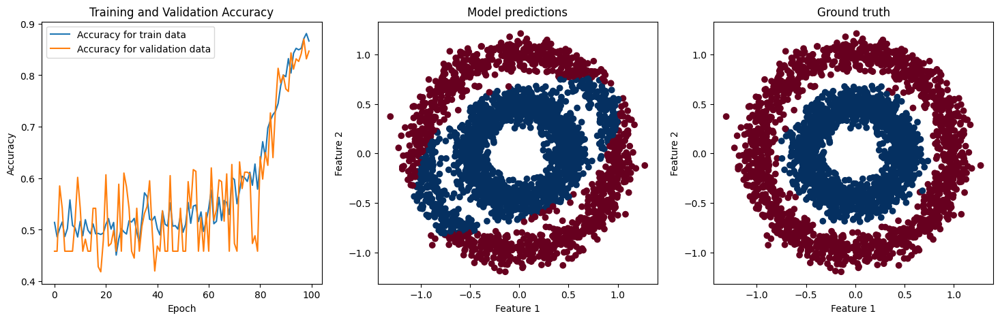

Test loss:  0.5979300737380981
Test accuracy:  0.875
Model: "sequential_50"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_148 (Dense)           (None, 50)                150       
                                                                 
 dense_149 (Dense)           (None, 1)                 51        
                                                                 
Total params: 201 (804.00 Byte)
Trainable params: 201 (804.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  50
Number of layers:  2
Number of epochs:  10
94/94 [==============================] - 0s 1ms/step


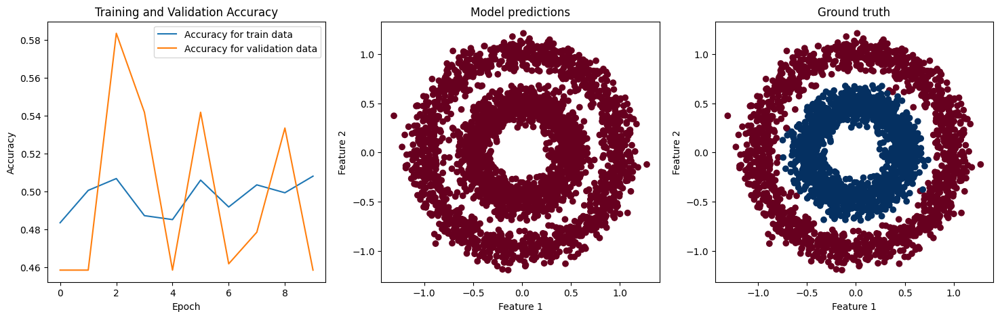

Test loss:  0.693803608417511
Test accuracy:  0.5026666522026062
Model: "sequential_51"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_150 (Dense)           (None, 50)                150       
                                                                 
 dense_151 (Dense)           (None, 50)                2550      
                                                                 
 dense_152 (Dense)           (None, 1)                 51        
                                                                 
Total params: 2751 (10.75 KB)
Trainable params: 2751 (10.75 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  50
Number of layers:  2
Number of epochs:  50
94/94 [==============================] - 0s 1ms/step


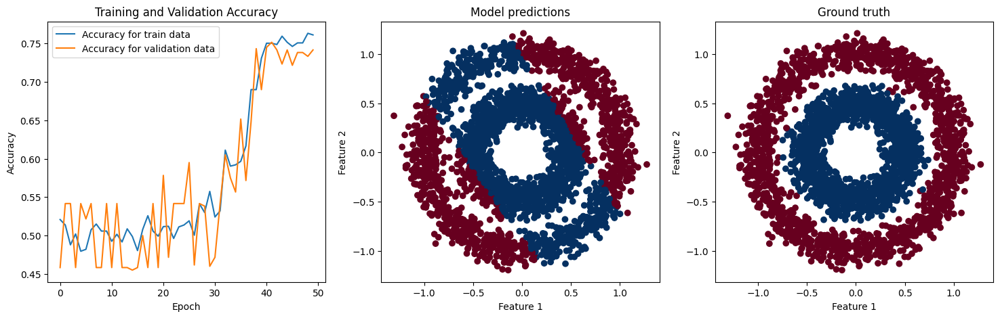

Test loss:  0.5102099776268005
Test accuracy:  0.7676666378974915
Model: "sequential_52"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_153 (Dense)           (None, 50)                150       
                                                                 
 dense_154 (Dense)           (None, 50)                2550      
                                                                 
 dense_155 (Dense)           (None, 1)                 51        
                                                                 
Total params: 2751 (10.75 KB)
Trainable params: 2751 (10.75 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  50
Number of layers:  2
Number of epochs:  100
94/94 [==============================] - 0s 1ms/step


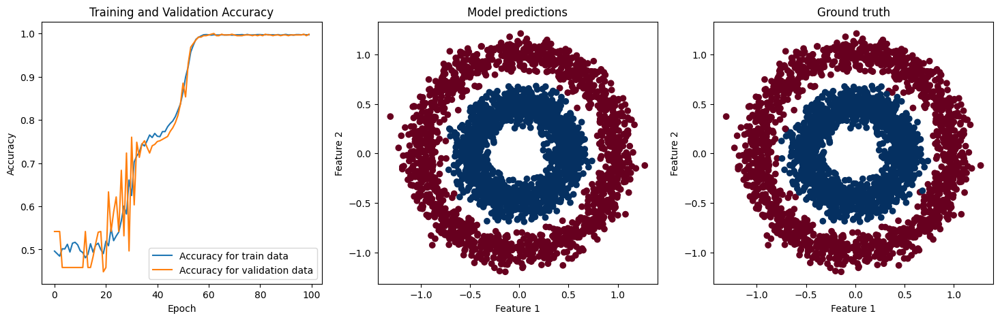

Test loss:  0.014705626294016838
Test accuracy:  0.9976666569709778
Model: "sequential_53"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_156 (Dense)           (None, 50)                150       
                                                                 
 dense_157 (Dense)           (None, 50)                2550      
                                                                 
 dense_158 (Dense)           (None, 1)                 51        
                                                                 
Total params: 2751 (10.75 KB)
Trainable params: 2751 (10.75 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  50
Number of layers:  3
Number of epochs:  10
94/94 [==============================] - 0s 1ms/step


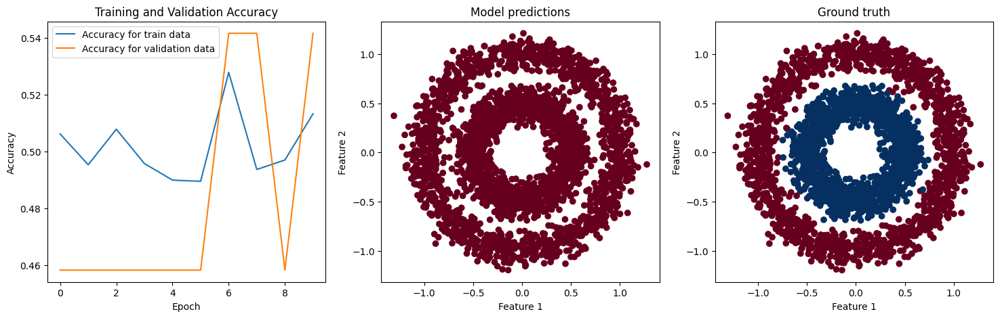

Test loss:  0.6940813064575195
Test accuracy:  0.4973333477973938
Model: "sequential_54"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_159 (Dense)           (None, 50)                150       
                                                                 
 dense_160 (Dense)           (None, 50)                2550      
                                                                 
 dense_161 (Dense)           (None, 50)                2550      
                                                                 
 dense_162 (Dense)           (None, 1)                 51        
                                                                 
Total params: 5301 (20.71 KB)
Trainable params: 5301 (20.71 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  5

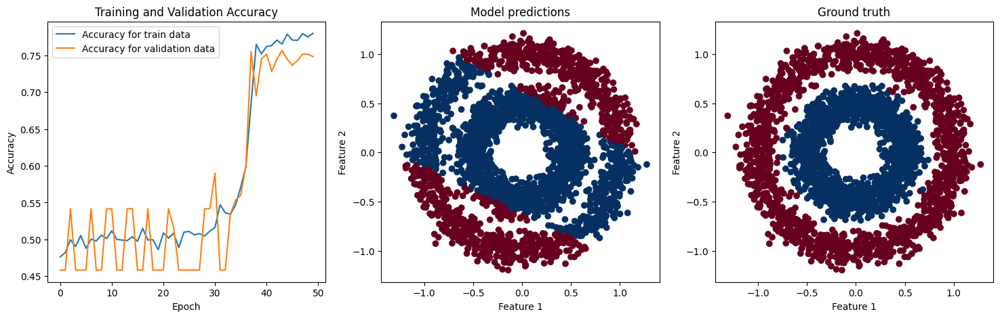

Test loss:  0.475257933139801
Test accuracy:  0.7730000019073486
Model: "sequential_55"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_163 (Dense)           (None, 50)                150       
                                                                 
 dense_164 (Dense)           (None, 50)                2550      
                                                                 
 dense_165 (Dense)           (None, 50)                2550      
                                                                 
 dense_166 (Dense)           (None, 1)                 51        
                                                                 
Total params: 5301 (20.71 KB)
Trainable params: 5301 (20.71 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  50

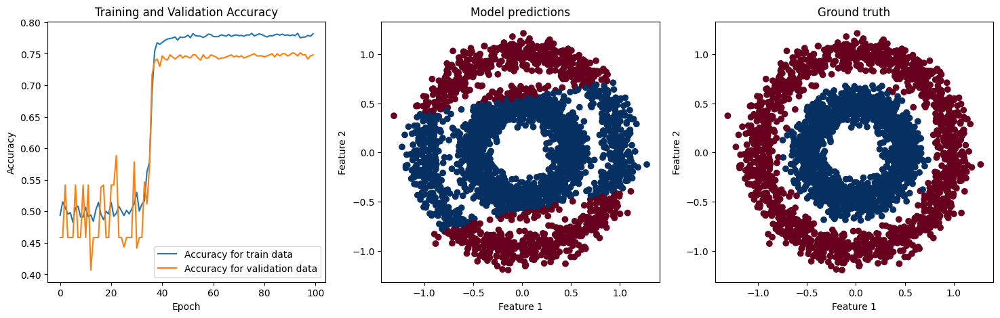

Test loss:  0.4584541916847229
Test accuracy:  0.7743333578109741
Model: "sequential_56"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_167 (Dense)           (None, 50)                150       
                                                                 
 dense_168 (Dense)           (None, 50)                2550      
                                                                 
 dense_169 (Dense)           (None, 50)                2550      
                                                                 
 dense_170 (Dense)           (None, 1)                 51        
                                                                 
Total params: 5301 (20.71 KB)
Trainable params: 5301 (20.71 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  5

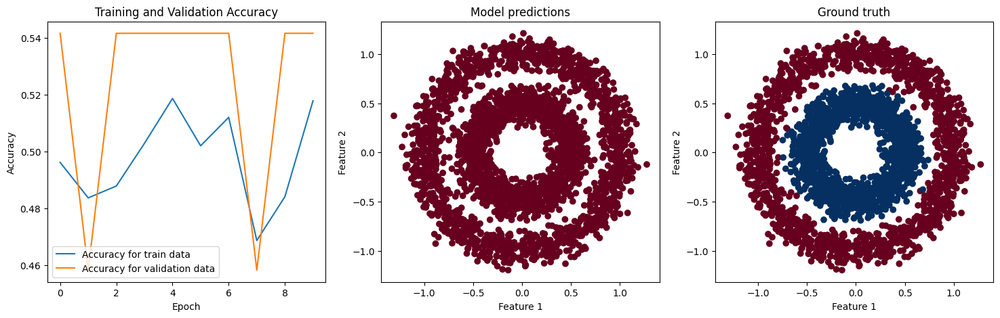

Test loss:  0.699341893196106
Test accuracy:  0.4973333477973938
Model: "sequential_57"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_171 (Dense)           (None, 50)                150       
                                                                 
 dense_172 (Dense)           (None, 50)                2550      
                                                                 
 dense_173 (Dense)           (None, 50)                2550      
                                                                 
 dense_174 (Dense)           (None, 50)                2550      
                                                                 
 dense_175 (Dense)           (None, 1)                 51        
                                                                 
Total params: 7851 (30.67 KB)
Trainable params: 7851 (30.67 KB)
Non-trainable params: 0 (0.00 Byte)
____________________

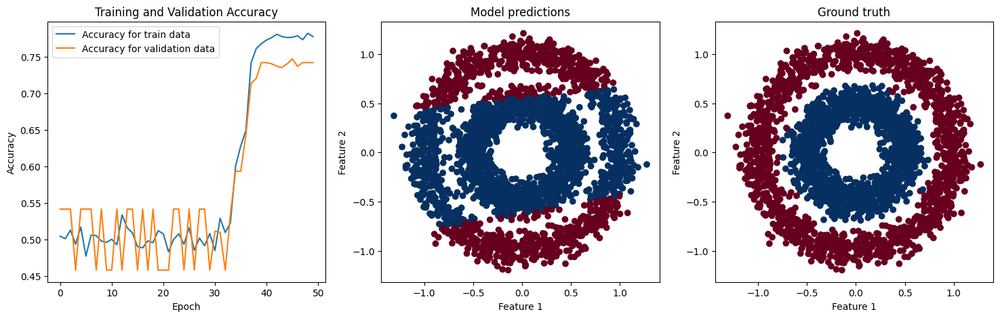

Test loss:  0.4649583399295807
Test accuracy:  0.7789999842643738
Model: "sequential_58"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_176 (Dense)           (None, 50)                150       
                                                                 
 dense_177 (Dense)           (None, 50)                2550      
                                                                 
 dense_178 (Dense)           (None, 50)                2550      
                                                                 
 dense_179 (Dense)           (None, 50)                2550      
                                                                 
 dense_180 (Dense)           (None, 1)                 51        
                                                                 
Total params: 7851 (30.67 KB)
Trainable params: 7851 (30.67 KB)
Non-trainable params: 0 (0.00 Byte)
___________________

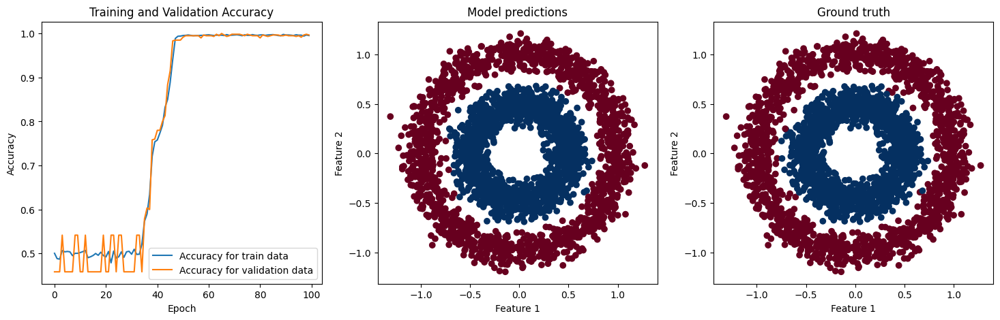

Test loss:  0.008314728736877441
Test accuracy:  0.996666669845581
Model: "sequential_59"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_181 (Dense)           (None, 50)                150       
                                                                 
 dense_182 (Dense)           (None, 50)                2550      
                                                                 
 dense_183 (Dense)           (None, 50)                2550      
                                                                 
 dense_184 (Dense)           (None, 50)                2550      
                                                                 
 dense_185 (Dense)           (None, 1)                 51        
                                                                 
Total params: 7851 (30.67 KB)
Trainable params: 7851 (30.67 KB)
Non-trainable params: 0 (0.00 Byte)
__________________

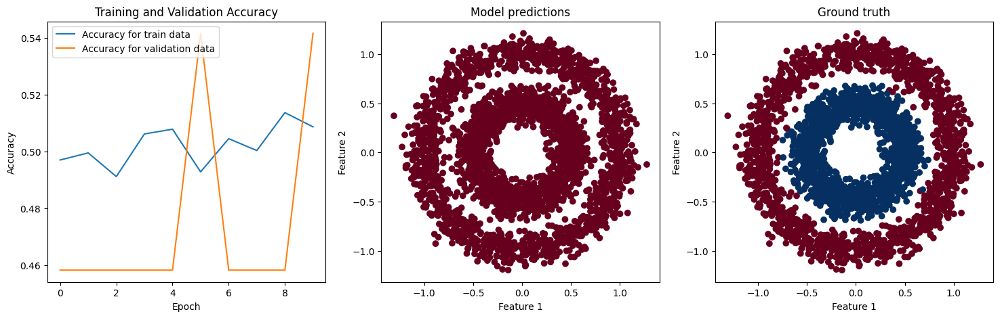

Test loss:  0.6944820880889893
Test accuracy:  0.4973333477973938
Model: "sequential_60"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_186 (Dense)           (None, 50)                150       
                                                                 
 dense_187 (Dense)           (None, 50)                2550      
                                                                 
 dense_188 (Dense)           (None, 50)                2550      
                                                                 
 dense_189 (Dense)           (None, 50)                2550      
                                                                 
 dense_190 (Dense)           (None, 50)                2550      
                                                                 
 dense_191 (Dense)           (None, 1)                 51        
                                                     

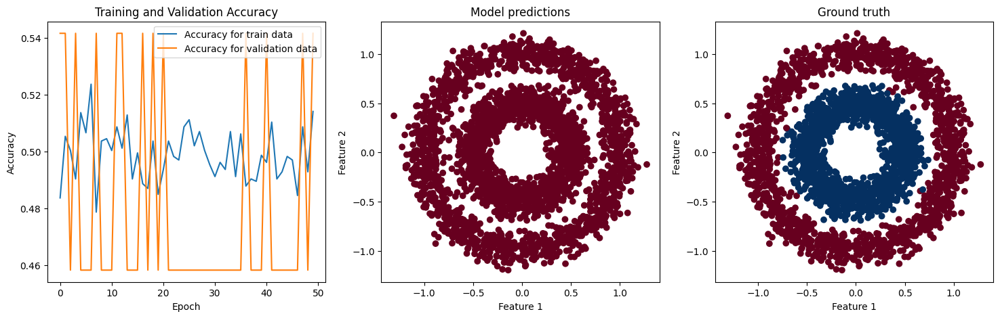

Test loss:  0.6935023069381714
Test accuracy:  0.4973333477973938
Model: "sequential_61"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_192 (Dense)           (None, 50)                150       
                                                                 
 dense_193 (Dense)           (None, 50)                2550      
                                                                 
 dense_194 (Dense)           (None, 50)                2550      
                                                                 
 dense_195 (Dense)           (None, 50)                2550      
                                                                 
 dense_196 (Dense)           (None, 50)                2550      
                                                                 
 dense_197 (Dense)           (None, 1)                 51        
                                                     

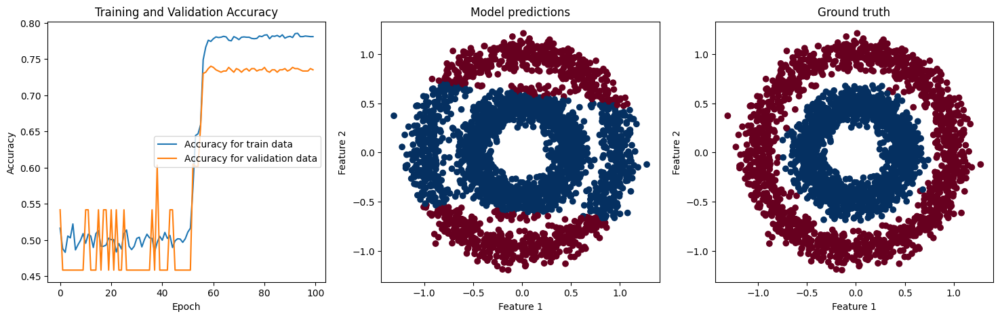

Test loss:  0.4582982063293457
Test accuracy:  0.7756666541099548
Model: "sequential_62"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_198 (Dense)           (None, 50)                150       
                                                                 
 dense_199 (Dense)           (None, 50)                2550      
                                                                 
 dense_200 (Dense)           (None, 50)                2550      
                                                                 
 dense_201 (Dense)           (None, 50)                2550      
                                                                 
 dense_202 (Dense)           (None, 50)                2550      
                                                                 
 dense_203 (Dense)           (None, 1)                 51        
                                                     

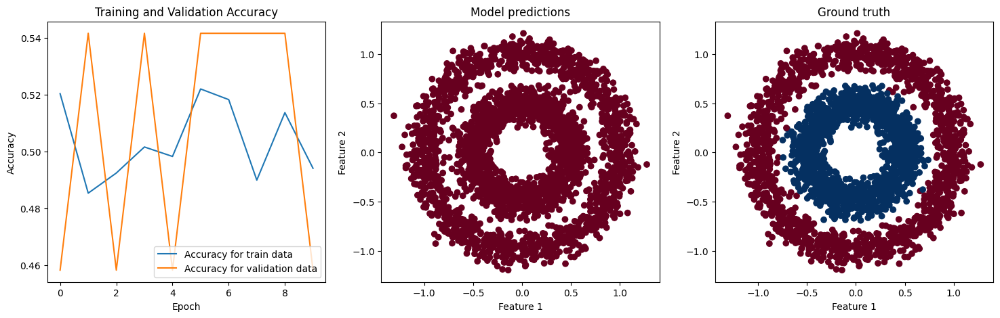

Test loss:  0.6989612579345703
Test accuracy:  0.5026666522026062
Model: "sequential_63"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_204 (Dense)           (None, 1000)              3000      
                                                                 
 dense_205 (Dense)           (None, 1)                 1001      
                                                                 
Total params: 4001 (15.63 KB)
Trainable params: 4001 (15.63 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  1000
Number of layers:  1
Number of epochs:  50
94/94 [==============================] - 0s 1ms/step


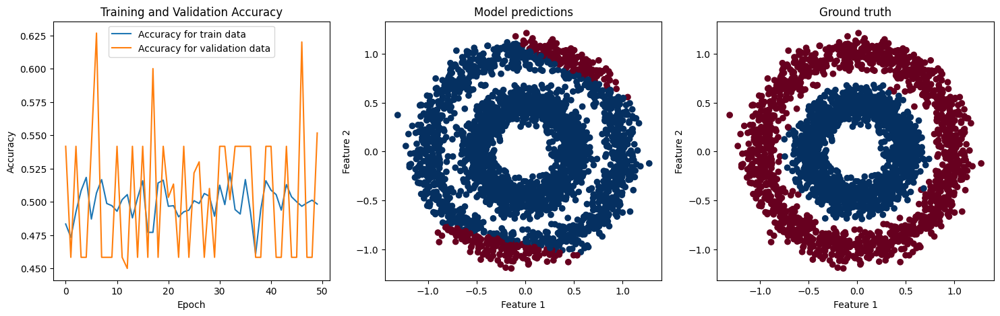

Test loss:  0.6890045404434204
Test accuracy:  0.6036666631698608
Model: "sequential_64"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_206 (Dense)           (None, 1000)              3000      
                                                                 
 dense_207 (Dense)           (None, 1)                 1001      
                                                                 
Total params: 4001 (15.63 KB)
Trainable params: 4001 (15.63 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  1000
Number of layers:  1
Number of epochs:  100
94/94 [==============================] - 0s 1ms/step


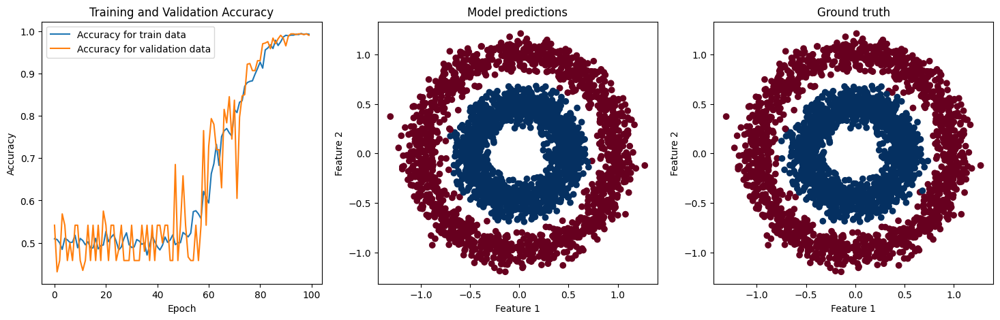

Test loss:  0.20264185965061188
Test accuracy:  0.996666669845581
Model: "sequential_65"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_208 (Dense)           (None, 1000)              3000      
                                                                 
 dense_209 (Dense)           (None, 1)                 1001      
                                                                 
Total params: 4001 (15.63 KB)
Trainable params: 4001 (15.63 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  1000
Number of layers:  2
Number of epochs:  10
94/94 [==============================] - 0s 2ms/step


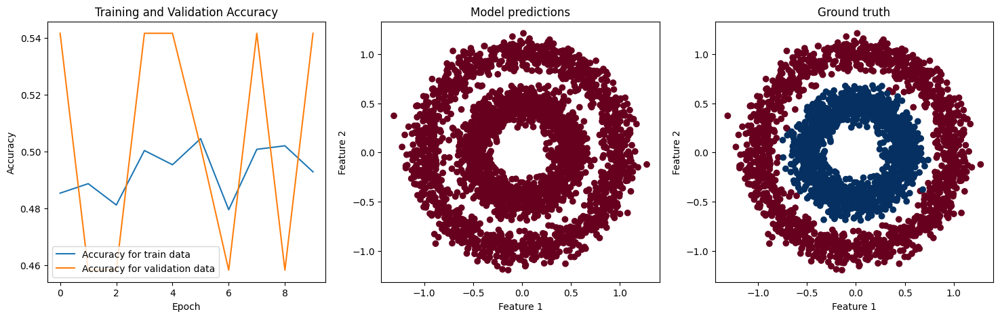

Test loss:  0.6957651376724243
Test accuracy:  0.4973333477973938
Model: "sequential_66"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_210 (Dense)           (None, 1000)              3000      
                                                                 
 dense_211 (Dense)           (None, 1000)              1001000   
                                                                 
 dense_212 (Dense)           (None, 1)                 1001      
                                                                 
Total params: 1005001 (3.83 MB)
Trainable params: 1005001 (3.83 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  1000
Number of layers:  2
Number of epochs:  50
94/94 [==============================] - 0s 2ms/step


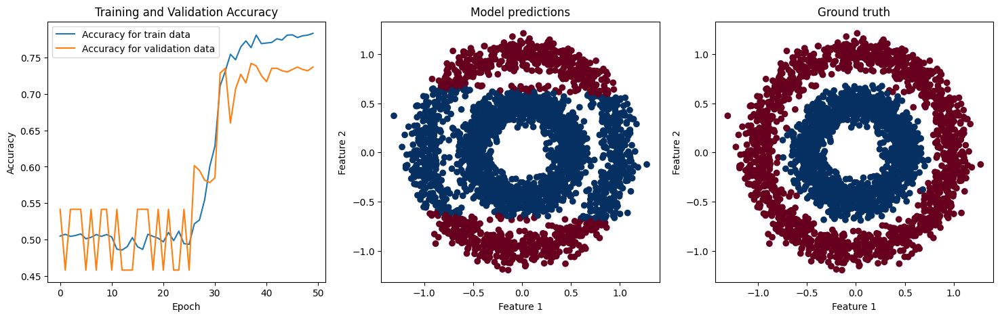

Test loss:  0.47814124822616577
Test accuracy:  0.7710000276565552
Model: "sequential_67"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_213 (Dense)           (None, 1000)              3000      
                                                                 
 dense_214 (Dense)           (None, 1000)              1001000   
                                                                 
 dense_215 (Dense)           (None, 1)                 1001      
                                                                 
Total params: 1005001 (3.83 MB)
Trainable params: 1005001 (3.83 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  1000
Number of layers:  2
Number of epochs:  100
94/94 [==============================] - 0s 2ms/step


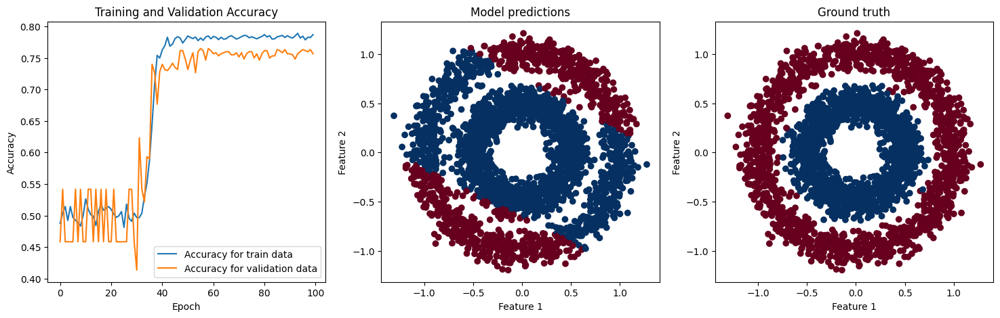

Test loss:  0.4761679172515869
Test accuracy:  0.7666666507720947
Model: "sequential_68"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_216 (Dense)           (None, 1000)              3000      
                                                                 
 dense_217 (Dense)           (None, 1000)              1001000   
                                                                 
 dense_218 (Dense)           (None, 1)                 1001      
                                                                 
Total params: 1005001 (3.83 MB)
Trainable params: 1005001 (3.83 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  1000
Number of layers:  3
Number of epochs:  10
94/94 [==============================] - 0s 2ms/step


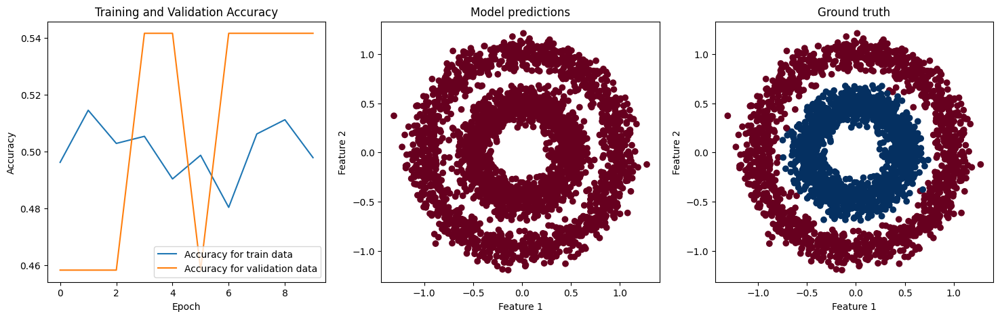

Test loss:  0.6994675397872925
Test accuracy:  0.4973333477973938
Model: "sequential_69"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_219 (Dense)           (None, 1000)              3000      
                                                                 
 dense_220 (Dense)           (None, 1000)              1001000   
                                                                 
 dense_221 (Dense)           (None, 1000)              1001000   
                                                                 
 dense_222 (Dense)           (None, 1)                 1001      
                                                                 
Total params: 2006001 (7.65 MB)
Trainable params: 2006001 (7.65 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons

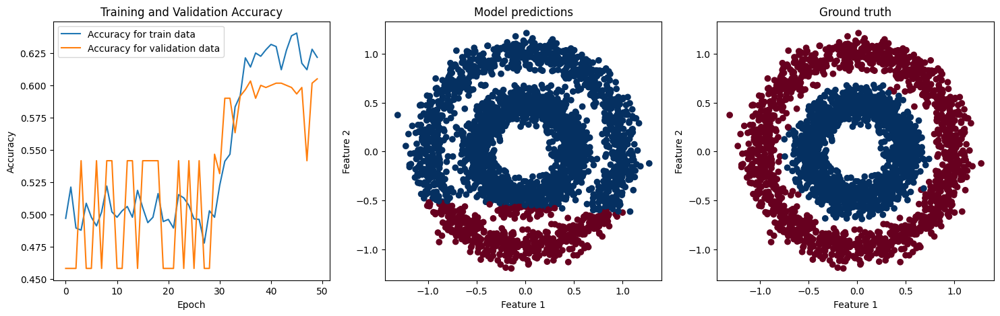

Test loss:  0.603807806968689
Test accuracy:  0.6296666860580444
Model: "sequential_70"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_223 (Dense)           (None, 1000)              3000      
                                                                 
 dense_224 (Dense)           (None, 1000)              1001000   
                                                                 
 dense_225 (Dense)           (None, 1000)              1001000   
                                                                 
 dense_226 (Dense)           (None, 1)                 1001      
                                                                 
Total params: 2006001 (7.65 MB)
Trainable params: 2006001 (7.65 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:

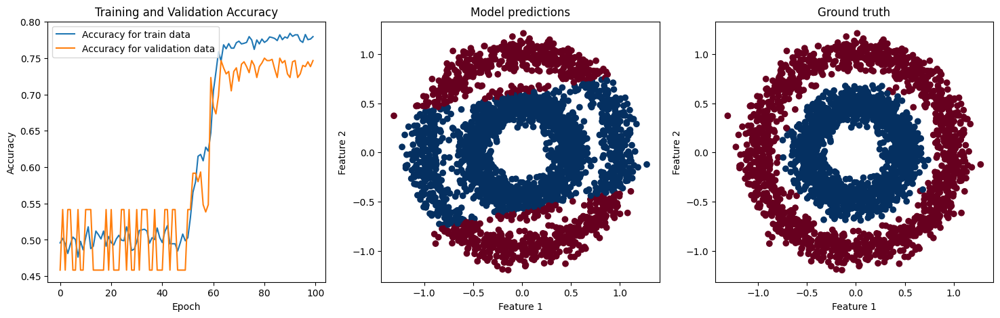

Test loss:  0.45757874846458435
Test accuracy:  0.7746666669845581
Model: "sequential_71"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_227 (Dense)           (None, 1000)              3000      
                                                                 
 dense_228 (Dense)           (None, 1000)              1001000   
                                                                 
 dense_229 (Dense)           (None, 1000)              1001000   
                                                                 
 dense_230 (Dense)           (None, 1)                 1001      
                                                                 
Total params: 2006001 (7.65 MB)
Trainable params: 2006001 (7.65 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neuron

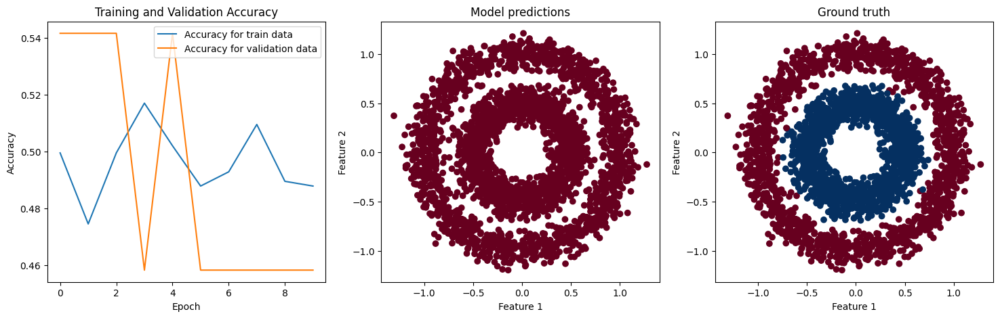

Test loss:  0.6973239183425903
Test accuracy:  0.5026666522026062
Model: "sequential_72"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_231 (Dense)           (None, 1000)              3000      
                                                                 
 dense_232 (Dense)           (None, 1000)              1001000   
                                                                 
 dense_233 (Dense)           (None, 1000)              1001000   
                                                                 
 dense_234 (Dense)           (None, 1000)              1001000   
                                                                 
 dense_235 (Dense)           (None, 1)                 1001      
                                                                 
Total params: 3007001 (11.47 MB)
Trainable params: 3007001 (11.47 MB)
Non-trainable params: 0 (0.00 Byte)
_____________

KeyboardInterrupt: 

In [16]:
# task 3
list_of_num_neurons = [ 20, 50, 1000]
list_of_num_layers = [1, 2, 3, 4, 5]
list_of_num_epochs = [10, 50, 100]

for num_neurons in list_of_num_neurons:
    for num_layers in list_of_num_layers:
        for num_epochs in list_of_num_epochs:
            print('Number of neurons: ', num_neurons)
            print('Number of layers: ', num_layers)
            print('Number of epochs: ', num_epochs)
            model = build_model(num_layers=num_layers, num_neurons=num_neurons)
            train_and_evaluate_model(model, epochs=num_epochs, plot=True)
            print('------------------------------------------')

# Evaluation and Analysis
Use similar evaluation and visualization code as in the previous exercise to assess model performance.
Answer questions like:
1. What signs of underfitting did you observe?
2. What were the indications of overfitting?
3. Describe the architecture of the balanced model and its performance.

# Conclusion
Reflect on the importance of matching model complexity with the problem complexity and discuss the trade-offs involved in designing neural network architectures.

------------------

# Regularization Technique: Early Stopping
## Objective
Understand how early stopping can be used as a regularization technique to prevent overfitting and improve the generalization of neural networks.

## Background
Early stopping is a form of regularization used to avoid overfitting when training a learner with an iterative method, such as gradient descent. It involves stopping the training process if the model's performance on a validation set starts to deteriorate, meaning the model begins to learn noise and details from the training data that negatively impact its performance on unseen data.

## How Early Stopping Works
* Monitor the model's performance on a validation set during training.
* If the performance on the validation set stops improving or starts to worsen, stop the training.
* Often, a 'patience' parameter is set to allow some leeway, meaning training will stop only after the model's performance hasn't improved for a specified number of epochs.


# Implementation in TensorFlow
TensorFlow provides an easy way to implement early stopping through callbacks. Here’s how you can add early stopping to your training process:

In [4]:
from tensorflow.keras.callbacks import EarlyStopping

# Create an EarlyStopping callback instance
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Include this callback in the model's fit method
model.fit(X_train, y_train, epochs=100, validation_split=0.2, callbacks=[early_stopping], verbose=0)


Epoch 1/100
75/75 [==============================] - 0s 3ms/step - loss: 0.5922 - accuracy: 0.7575 - val_loss: 0.6001 - val_accuracy: 0.7250
Epoch 2/100
75/75 [==============================] - 0s 2ms/step - loss: 0.5847 - accuracy: 0.7667 - val_loss: 0.5930 - val_accuracy: 0.7383
Epoch 3/100
75/75 [==============================] - 0s 2ms/step - loss: 0.5771 - accuracy: 0.7708 - val_loss: 0.5886 - val_accuracy: 0.7433
Epoch 4/100
75/75 [==============================] - 0s 2ms/step - loss: 0.5697 - accuracy: 0.7779 - val_loss: 0.5801 - val_accuracy: 0.7467
Epoch 5/100
75/75 [==============================] - 0s 2ms/step - loss: 0.5626 - accuracy: 0.7746 - val_loss: 0.5734 - val_accuracy: 0.7383
Epoch 6/100
75/75 [==============================] - 0s 2ms/step - loss: 0.5562 - accuracy: 0.7738 - val_loss: 0.5703 - val_accuracy: 0.7417
Epoch 7/100
75/75 [==============================] - 0s 2ms/step - loss: 0.5495 - accuracy: 0.7725 - val_loss: 0.5665 - val_accuracy: 0.7417
Epoch 8/100
7

## Task
1. Add early stopping to your neural network training process using the above code snippet.
2. Experiment with different values for the patience parameter and observe how it impacts the training process and the model's performance.

## Analysis and Questions
* How does early stopping affect the number of epochs for which your model trains?
* Did you observe any improvements in the generalization of your model to the test data?
* How does the patience parameter impact the effectiveness of early stopping?

## Conclusion
Reflect on the importance of regularization techniques like early stopping in preventing overfitting and improving model generalization.

94/94 [==============================] - 0s 2ms/step


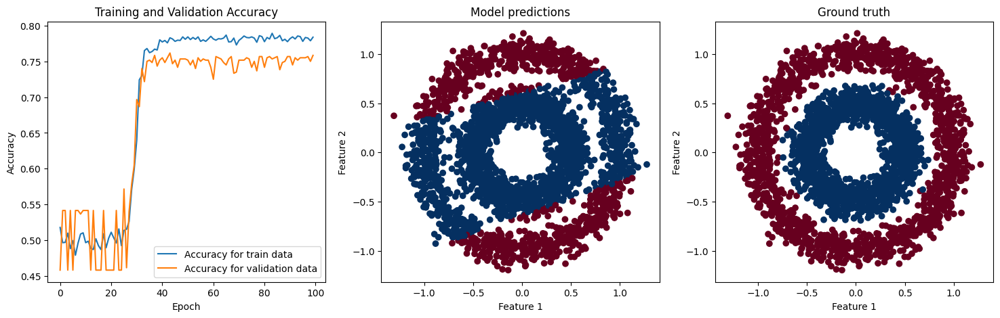

Test loss:  0.45906126499176025
Test accuracy:  0.7730000019073486
Model: "sequential_75"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_244 (Dense)           (None, 1000)              3000      
                                                                 
 dense_245 (Dense)           (None, 1000)              1001000   
                                                                 
 dense_246 (Dense)           (None, 1)                 1001      
                                                                 
Total params: 1005001 (3.83 MB)
Trainable params: 1005001 (3.83 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None


In [18]:
import tensorflow as tf

def train_and_evaluate_model(model, epochs=50, plot=True, patience=5):
    # early stopping
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=patience, restore_best_weights=True)
    # Train the model
    history = model.fit(X_train, y_train, epochs=epochs,callbacks=[early_stopping], verbose=0, validation_split=0.2)
    

    # Evaluate the model on the test set
    # TASK: Fill in the evaluation code here
    test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=0)

    # Plotting (if enabled)
    if plot:
        plt.figure(figsize=(18, 5))
        plt.subplot(1, 3, 1)

        # Plot training and validation accuracy
        # TASK: Add code to plot training history
        plt.plot(history.history['accuracy'], label='Accuracy for train data')
        plt.plot(history.history['val_accuracy'], label='Accuracy for validation data')
        plt.title('Training and Validation Accuracy')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()

        model.predict(X_test) > 0.5
        # Plot model predictions vs. ground truth on the test set
        plt.subplot(1, 3, 2)
        plt.scatter(X_test[:, 0], X_test[:, 1], c=model.predict(X_test) > 0.5, cmap=plt.cm.RdBu)
        plt.title("Model predictions")
        plt.xlabel("Feature 1")
        plt.ylabel("Feature 2")
        
        # TASK: Add code to plot model predictions and ground truth
        plt.subplot(1, 3, 3)
        plt.scatter(X_test[:, 0], X_test[:, 1], c=y_test, cmap=plt.cm.RdBu)
        plt.title("Ground truth")
        plt.xlabel("Feature 1")
        plt.ylabel("Feature 2")

        plt.show()

    # TASK: Print or return any other metrics or plots you think are necessary
    print('Test loss: ', test_loss)
    print('Test accuracy: ', test_accuracy)
    print('Model summary: ', model.summary())


# Example of using the function with a specific architecture
model = build_model(num_layers=2, num_neurons=1000)
train_and_evaluate_model(model, epochs=100, patience=100)

Number of neurons:  20
Number of layers:  3
Number of epochs:  100
Patience:  50
94/94 [==============================] - 0s 1ms/step


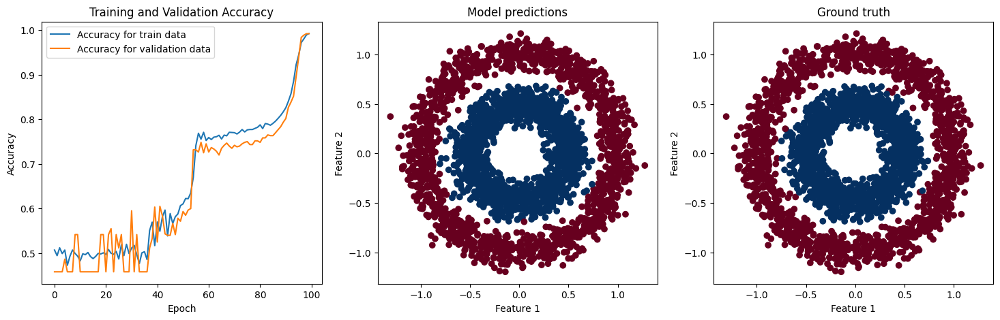

Test loss:  0.11511016637086868
Test accuracy:  0.9959999918937683
Model: "sequential_76"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_247 (Dense)           (None, 20)                60        
                                                                 
 dense_248 (Dense)           (None, 20)                420       
                                                                 
 dense_249 (Dense)           (None, 20)                420       
                                                                 
 dense_250 (Dense)           (None, 1)                 21        
                                                                 
Total params: 921 (3.60 KB)
Trainable params: 921 (3.60 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
N

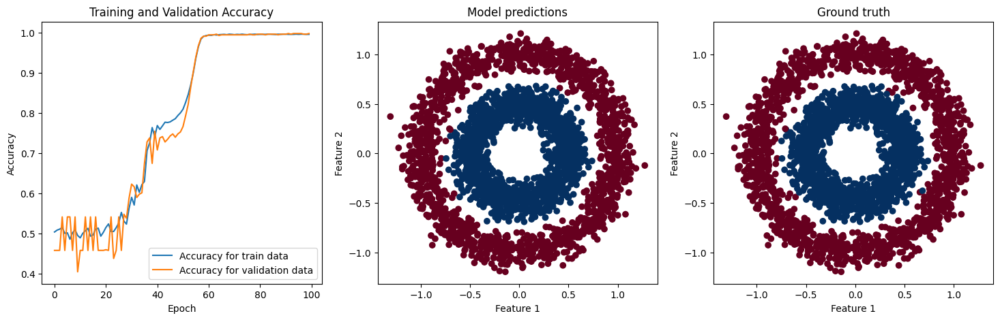

Test loss:  0.01069176010787487
Test accuracy:  0.9976666569709778
Model: "sequential_77"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_251 (Dense)           (None, 20)                60        
                                                                 
 dense_252 (Dense)           (None, 20)                420       
                                                                 
 dense_253 (Dense)           (None, 20)                420       
                                                                 
 dense_254 (Dense)           (None, 1)                 21        
                                                                 
Total params: 921 (3.60 KB)
Trainable params: 921 (3.60 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
N

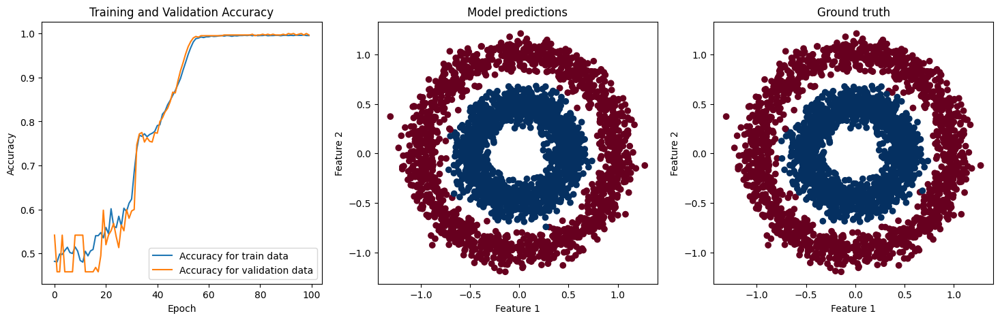

Test loss:  0.012523798272013664
Test accuracy:  0.996666669845581
Model: "sequential_78"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_255 (Dense)           (None, 20)                60        
                                                                 
 dense_256 (Dense)           (None, 20)                420       
                                                                 
 dense_257 (Dense)           (None, 20)                420       
                                                                 
 dense_258 (Dense)           (None, 1)                 21        
                                                                 
Total params: 921 (3.60 KB)
Trainable params: 921 (3.60 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
N

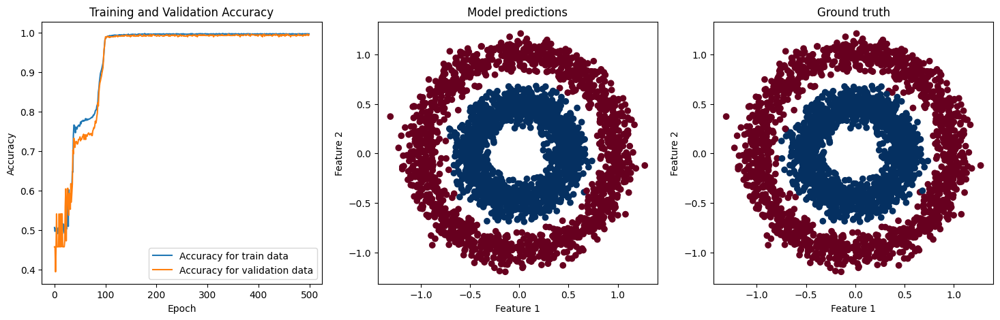

Test loss:  0.006235925015062094
Test accuracy:  0.996666669845581
Model: "sequential_79"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_259 (Dense)           (None, 20)                60        
                                                                 
 dense_260 (Dense)           (None, 20)                420       
                                                                 
 dense_261 (Dense)           (None, 20)                420       
                                                                 
 dense_262 (Dense)           (None, 1)                 21        
                                                                 
Total params: 921 (3.60 KB)
Trainable params: 921 (3.60 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
N

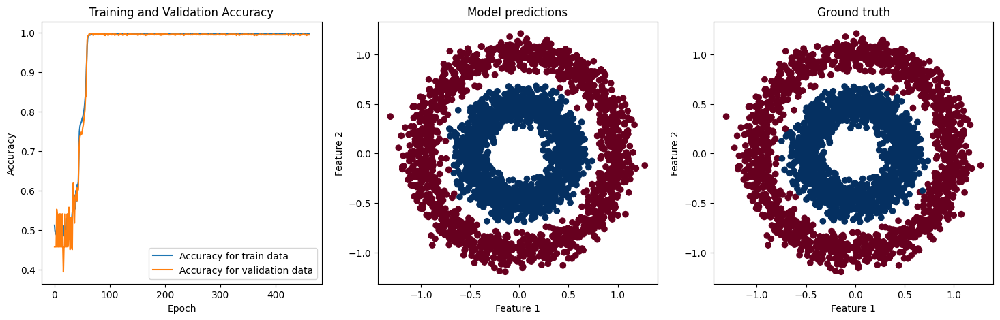

Test loss:  0.007111267652362585
Test accuracy:  0.996999979019165
Model: "sequential_80"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_263 (Dense)           (None, 20)                60        
                                                                 
 dense_264 (Dense)           (None, 20)                420       
                                                                 
 dense_265 (Dense)           (None, 20)                420       
                                                                 
 dense_266 (Dense)           (None, 1)                 21        
                                                                 
Total params: 921 (3.60 KB)
Trainable params: 921 (3.60 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
N

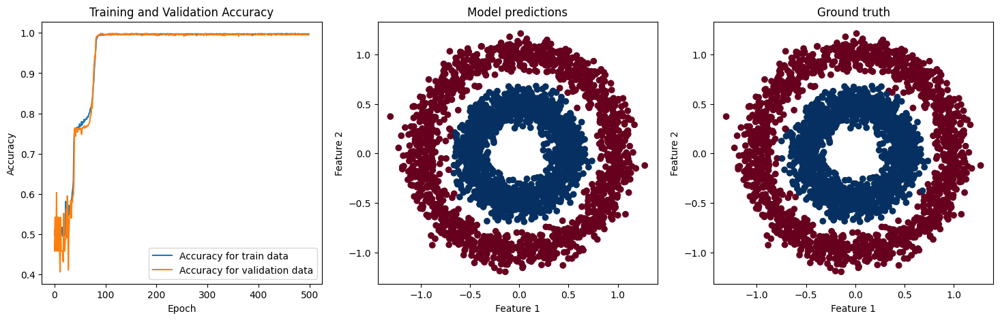

Test loss:  0.008455858565866947
Test accuracy:  0.996999979019165
Model: "sequential_81"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_267 (Dense)           (None, 20)                60        
                                                                 
 dense_268 (Dense)           (None, 20)                420       
                                                                 
 dense_269 (Dense)           (None, 20)                420       
                                                                 
 dense_270 (Dense)           (None, 1)                 21        
                                                                 
Total params: 921 (3.60 KB)
Trainable params: 921 (3.60 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
N

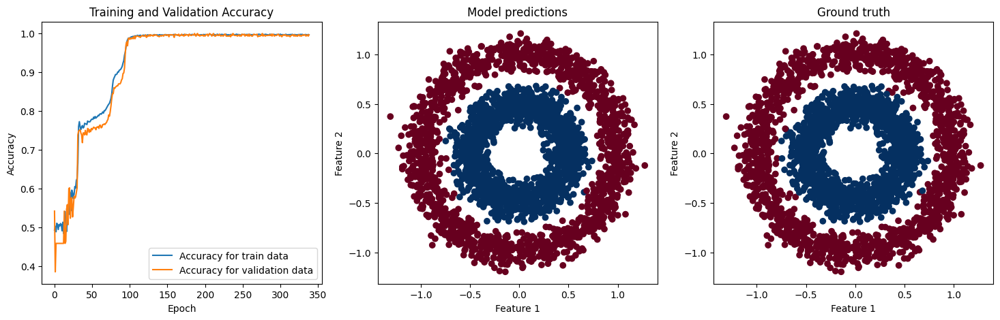

Test loss:  0.007502126041799784
Test accuracy:  0.996999979019165
Model: "sequential_82"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_271 (Dense)           (None, 20)                60        
                                                                 
 dense_272 (Dense)           (None, 20)                420       
                                                                 
 dense_273 (Dense)           (None, 20)                420       
                                                                 
 dense_274 (Dense)           (None, 1)                 21        
                                                                 
Total params: 921 (3.60 KB)
Trainable params: 921 (3.60 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
N

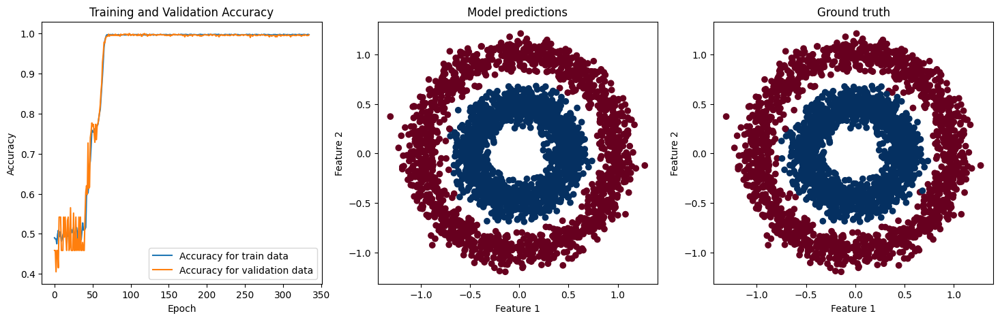

Test loss:  0.006331714801490307
Test accuracy:  0.996999979019165
Model: "sequential_83"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_275 (Dense)           (None, 20)                60        
                                                                 
 dense_276 (Dense)           (None, 20)                420       
                                                                 
 dense_277 (Dense)           (None, 20)                420       
                                                                 
 dense_278 (Dense)           (None, 1)                 21        
                                                                 
Total params: 921 (3.60 KB)
Trainable params: 921 (3.60 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20
N

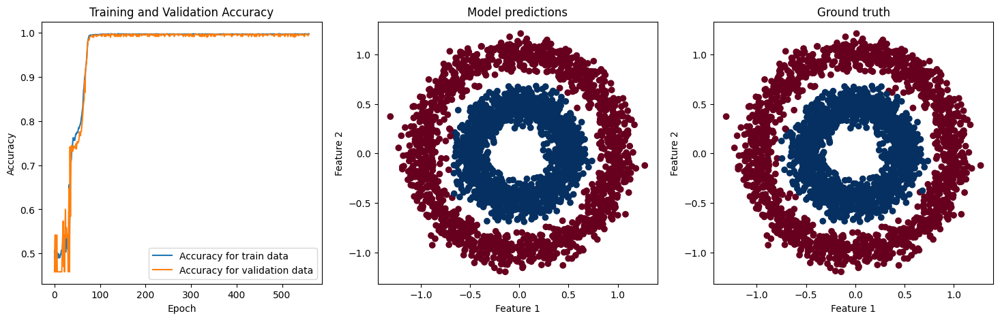

Test loss:  0.007376488298177719
Test accuracy:  0.9963333606719971
Model: "sequential_84"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_279 (Dense)           (None, 20)                60        
                                                                 
 dense_280 (Dense)           (None, 20)                420       
                                                                 
 dense_281 (Dense)           (None, 20)                420       
                                                                 
 dense_282 (Dense)           (None, 1)                 21        
                                                                 
Total params: 921 (3.60 KB)
Trainable params: 921 (3.60 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:  20


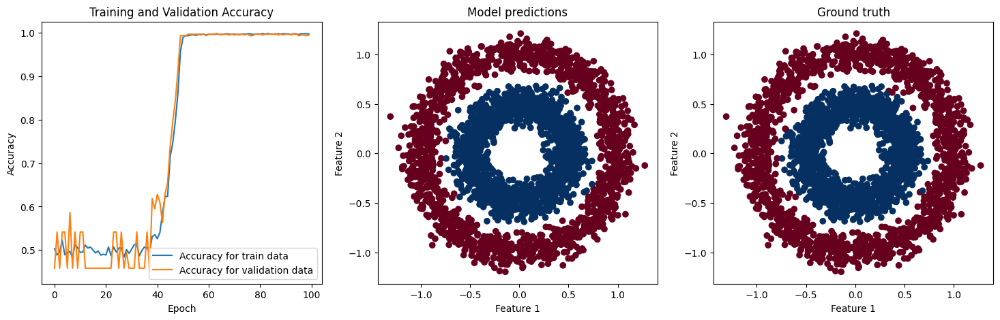

Test loss:  0.010697325691580772
Test accuracy:  0.996666669845581
Model: "sequential_85"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_283 (Dense)           (None, 20)                60        
                                                                 
 dense_284 (Dense)           (None, 20)                420       
                                                                 
 dense_285 (Dense)           (None, 20)                420       
                                                                 
 dense_286 (Dense)           (None, 20)                420       
                                                                 
 dense_287 (Dense)           (None, 1)                 21        
                                                                 
Total params: 1341 (5.24 KB)
Trainable params: 1341 (5.24 KB)
Non-trainable params: 0 (0.00 Byte)
____________________

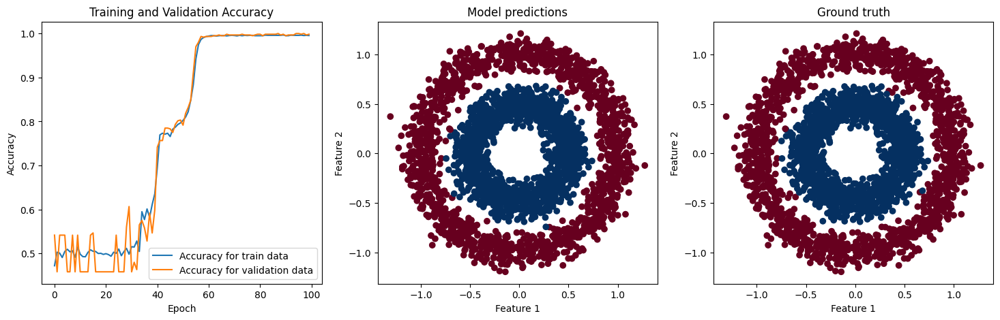

Test loss:  0.008629169315099716
Test accuracy:  0.996999979019165
Model: "sequential_86"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_288 (Dense)           (None, 20)                60        
                                                                 
 dense_289 (Dense)           (None, 20)                420       
                                                                 
 dense_290 (Dense)           (None, 20)                420       
                                                                 
 dense_291 (Dense)           (None, 20)                420       
                                                                 
 dense_292 (Dense)           (None, 1)                 21        
                                                                 
Total params: 1341 (5.24 KB)
Trainable params: 1341 (5.24 KB)
Non-trainable params: 0 (0.00 Byte)
____________________

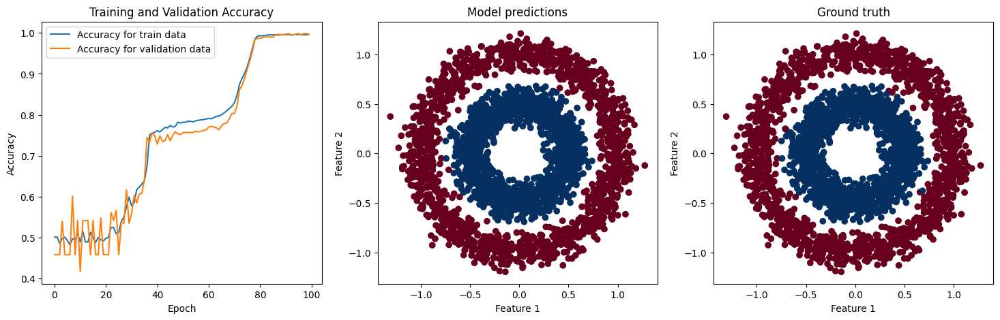

Test loss:  0.01259660255163908
Test accuracy:  0.9976666569709778
Model: "sequential_87"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_293 (Dense)           (None, 20)                60        
                                                                 
 dense_294 (Dense)           (None, 20)                420       
                                                                 
 dense_295 (Dense)           (None, 20)                420       
                                                                 
 dense_296 (Dense)           (None, 20)                420       
                                                                 
 dense_297 (Dense)           (None, 1)                 21        
                                                                 
Total params: 1341 (5.24 KB)
Trainable params: 1341 (5.24 KB)
Non-trainable params: 0 (0.00 Byte)
____________________

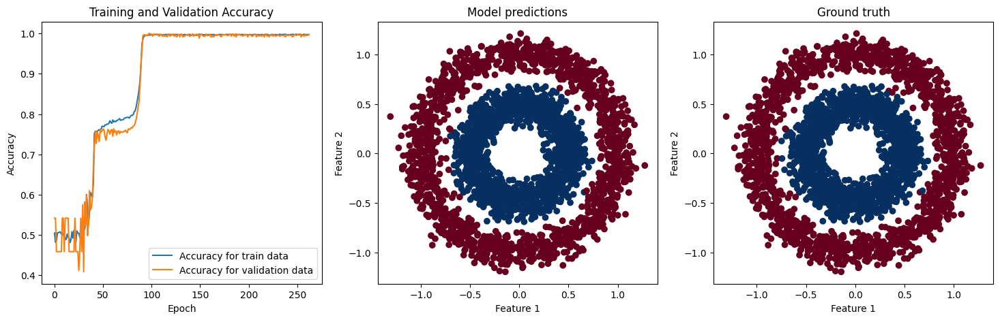

Test loss:  0.005313463043421507
Test accuracy:  0.9973333477973938
Model: "sequential_88"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_298 (Dense)           (None, 20)                60        
                                                                 
 dense_299 (Dense)           (None, 20)                420       
                                                                 
 dense_300 (Dense)           (None, 20)                420       
                                                                 
 dense_301 (Dense)           (None, 20)                420       
                                                                 
 dense_302 (Dense)           (None, 1)                 21        
                                                                 
Total params: 1341 (5.24 KB)
Trainable params: 1341 (5.24 KB)
Non-trainable params: 0 (0.00 Byte)
___________________

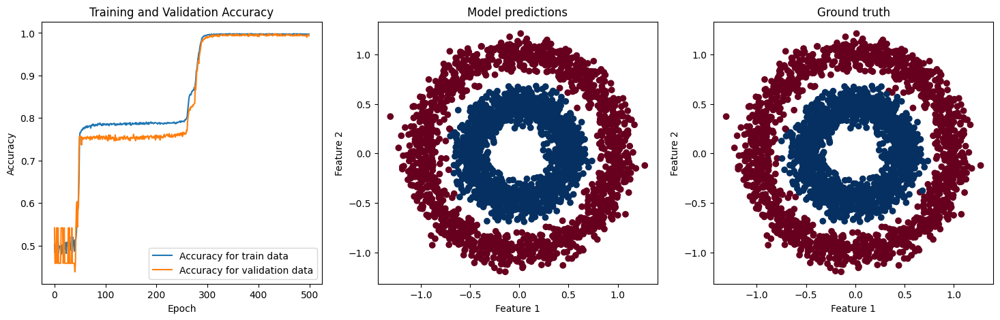

Test loss:  0.006763231474906206
Test accuracy:  0.9973333477973938
Model: "sequential_89"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_303 (Dense)           (None, 20)                60        
                                                                 
 dense_304 (Dense)           (None, 20)                420       
                                                                 
 dense_305 (Dense)           (None, 20)                420       
                                                                 
 dense_306 (Dense)           (None, 20)                420       
                                                                 
 dense_307 (Dense)           (None, 1)                 21        
                                                                 
Total params: 1341 (5.24 KB)
Trainable params: 1341 (5.24 KB)
Non-trainable params: 0 (0.00 Byte)
___________________

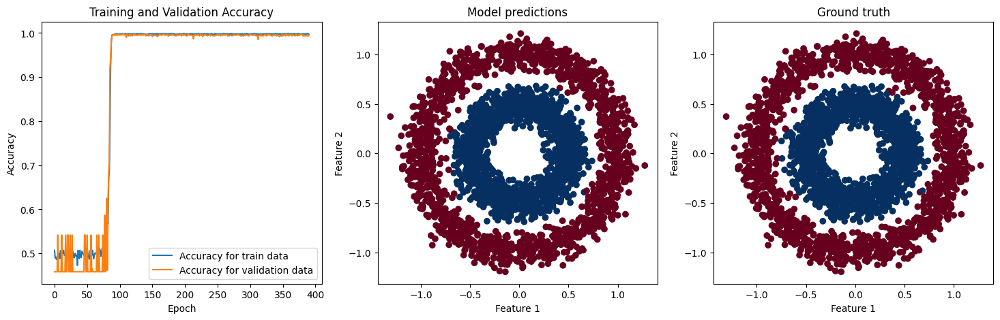

Test loss:  0.007601356599479914
Test accuracy:  0.996666669845581
Model: "sequential_90"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_308 (Dense)           (None, 20)                60        
                                                                 
 dense_309 (Dense)           (None, 20)                420       
                                                                 
 dense_310 (Dense)           (None, 20)                420       
                                                                 
 dense_311 (Dense)           (None, 20)                420       
                                                                 
 dense_312 (Dense)           (None, 1)                 21        
                                                                 
Total params: 1341 (5.24 KB)
Trainable params: 1341 (5.24 KB)
Non-trainable params: 0 (0.00 Byte)
____________________

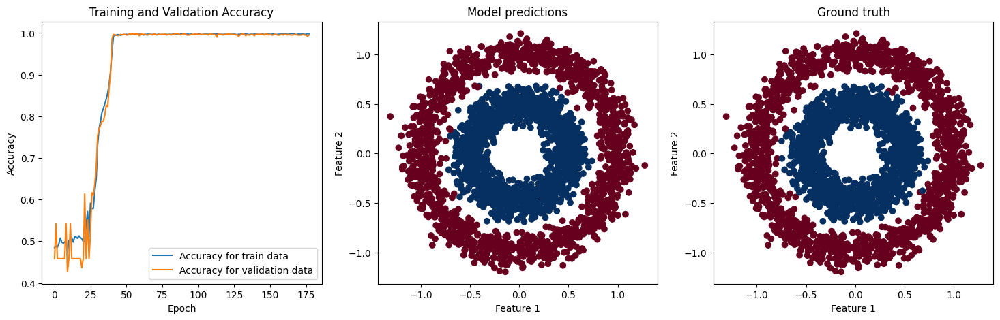

Test loss:  0.007182244677096605
Test accuracy:  0.996999979019165
Model: "sequential_91"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_313 (Dense)           (None, 20)                60        
                                                                 
 dense_314 (Dense)           (None, 20)                420       
                                                                 
 dense_315 (Dense)           (None, 20)                420       
                                                                 
 dense_316 (Dense)           (None, 20)                420       
                                                                 
 dense_317 (Dense)           (None, 1)                 21        
                                                                 
Total params: 1341 (5.24 KB)
Trainable params: 1341 (5.24 KB)
Non-trainable params: 0 (0.00 Byte)
____________________

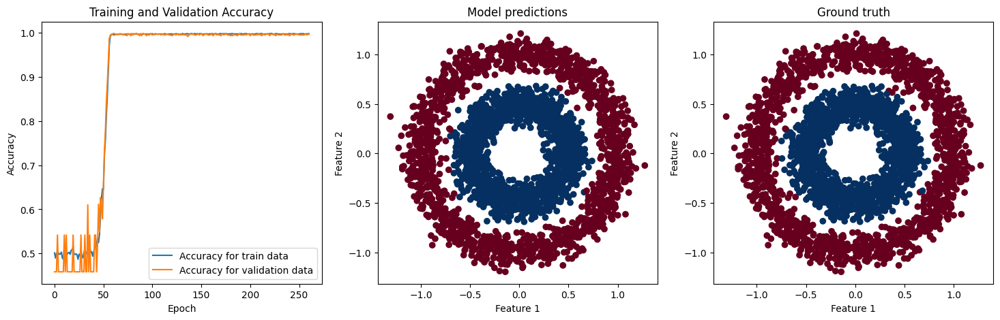

Test loss:  0.007274731993675232
Test accuracy:  0.996666669845581
Model: "sequential_92"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_318 (Dense)           (None, 20)                60        
                                                                 
 dense_319 (Dense)           (None, 20)                420       
                                                                 
 dense_320 (Dense)           (None, 20)                420       
                                                                 
 dense_321 (Dense)           (None, 20)                420       
                                                                 
 dense_322 (Dense)           (None, 1)                 21        
                                                                 
Total params: 1341 (5.24 KB)
Trainable params: 1341 (5.24 KB)
Non-trainable params: 0 (0.00 Byte)
____________________

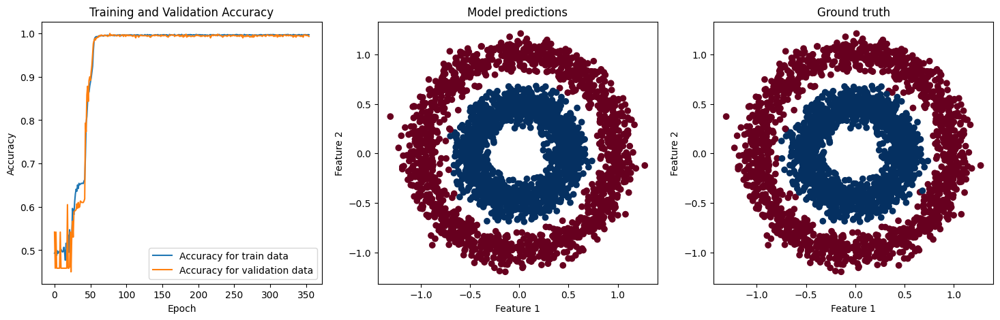

Test loss:  0.007193033117800951
Test accuracy:  0.996999979019165
Model: "sequential_93"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_323 (Dense)           (None, 20)                60        
                                                                 
 dense_324 (Dense)           (None, 20)                420       
                                                                 
 dense_325 (Dense)           (None, 20)                420       
                                                                 
 dense_326 (Dense)           (None, 20)                420       
                                                                 
 dense_327 (Dense)           (None, 1)                 21        
                                                                 
Total params: 1341 (5.24 KB)
Trainable params: 1341 (5.24 KB)
Non-trainable params: 0 (0.00 Byte)
____________________

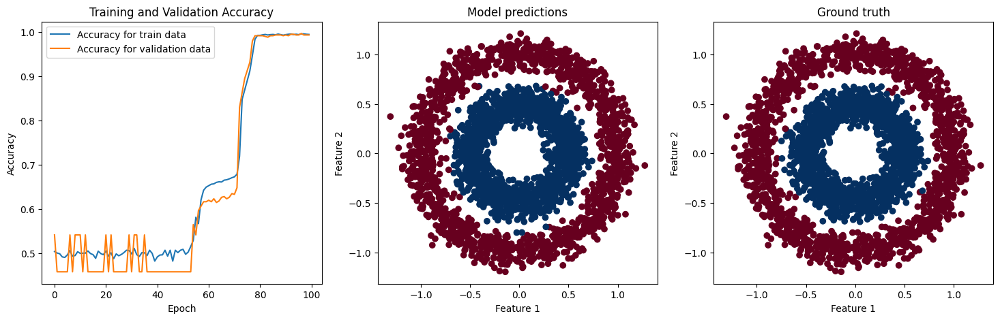

Test loss:  0.013954810798168182
Test accuracy:  0.9963333606719971
Model: "sequential_94"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_328 (Dense)           (None, 20)                60        
                                                                 
 dense_329 (Dense)           (None, 20)                420       
                                                                 
 dense_330 (Dense)           (None, 20)                420       
                                                                 
 dense_331 (Dense)           (None, 20)                420       
                                                                 
 dense_332 (Dense)           (None, 20)                420       
                                                                 
 dense_333 (Dense)           (None, 1)                 21        
                                                   

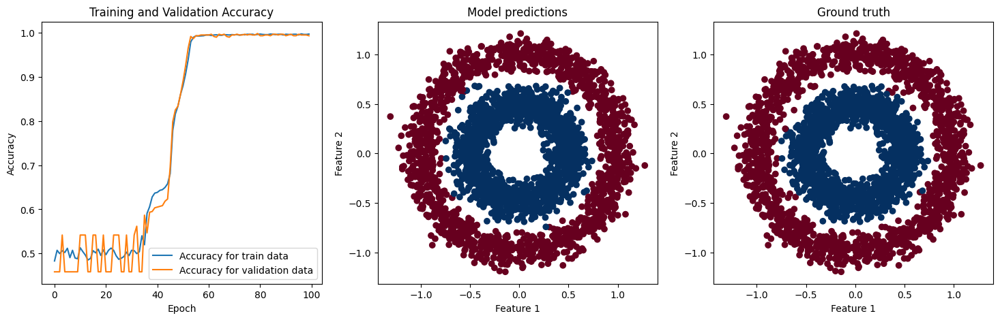

Test loss:  0.01810850016772747
Test accuracy:  0.9946666955947876
Model: "sequential_95"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_334 (Dense)           (None, 20)                60        
                                                                 
 dense_335 (Dense)           (None, 20)                420       
                                                                 
 dense_336 (Dense)           (None, 20)                420       
                                                                 
 dense_337 (Dense)           (None, 20)                420       
                                                                 
 dense_338 (Dense)           (None, 20)                420       
                                                                 
 dense_339 (Dense)           (None, 1)                 21        
                                                    

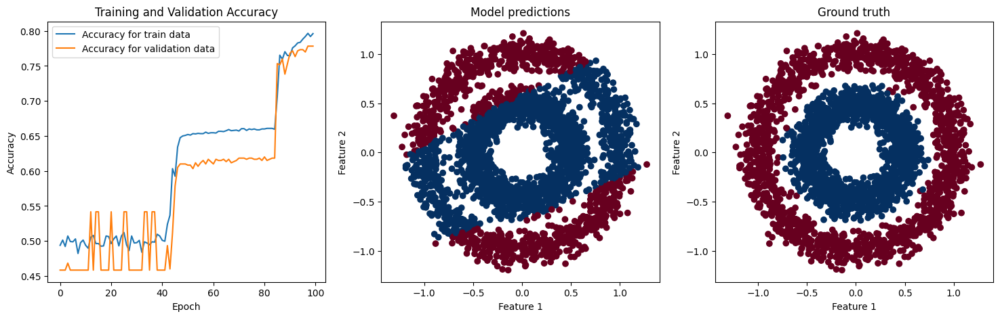

Test loss:  0.45140397548675537
Test accuracy:  0.7826666831970215
Model: "sequential_96"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_340 (Dense)           (None, 20)                60        
                                                                 
 dense_341 (Dense)           (None, 20)                420       
                                                                 
 dense_342 (Dense)           (None, 20)                420       
                                                                 
 dense_343 (Dense)           (None, 20)                420       
                                                                 
 dense_344 (Dense)           (None, 20)                420       
                                                                 
 dense_345 (Dense)           (None, 1)                 21        
                                                    

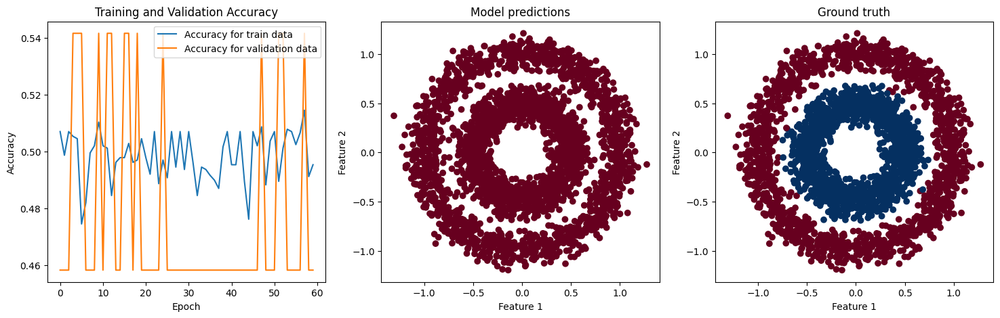

Test loss:  0.693782389163971
Test accuracy:  0.4973333477973938
Model: "sequential_97"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_346 (Dense)           (None, 20)                60        
                                                                 
 dense_347 (Dense)           (None, 20)                420       
                                                                 
 dense_348 (Dense)           (None, 20)                420       
                                                                 
 dense_349 (Dense)           (None, 20)                420       
                                                                 
 dense_350 (Dense)           (None, 20)                420       
                                                                 
 dense_351 (Dense)           (None, 1)                 21        
                                                      

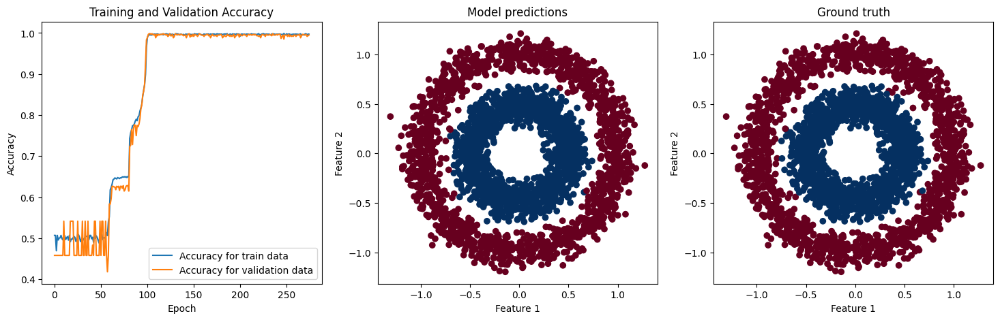

Test loss:  0.006999642588198185
Test accuracy:  0.996666669845581
Model: "sequential_98"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_352 (Dense)           (None, 20)                60        
                                                                 
 dense_353 (Dense)           (None, 20)                420       
                                                                 
 dense_354 (Dense)           (None, 20)                420       
                                                                 
 dense_355 (Dense)           (None, 20)                420       
                                                                 
 dense_356 (Dense)           (None, 20)                420       
                                                                 
 dense_357 (Dense)           (None, 1)                 21        
                                                    

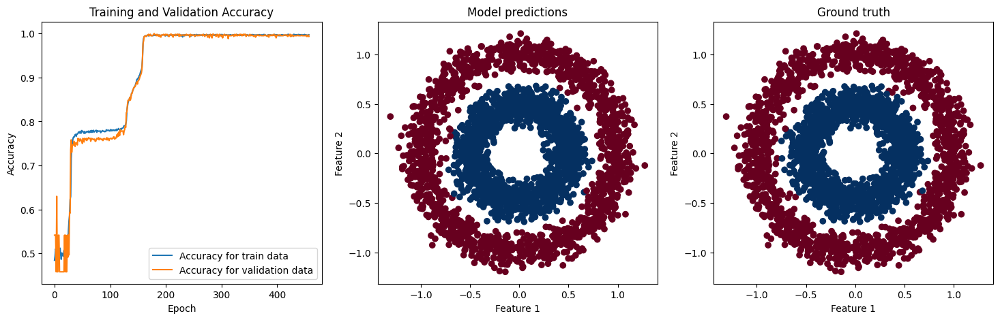

Test loss:  0.00859586801379919
Test accuracy:  0.996666669845581
Model: "sequential_99"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_358 (Dense)           (None, 20)                60        
                                                                 
 dense_359 (Dense)           (None, 20)                420       
                                                                 
 dense_360 (Dense)           (None, 20)                420       
                                                                 
 dense_361 (Dense)           (None, 20)                420       
                                                                 
 dense_362 (Dense)           (None, 20)                420       
                                                                 
 dense_363 (Dense)           (None, 1)                 21        
                                                     

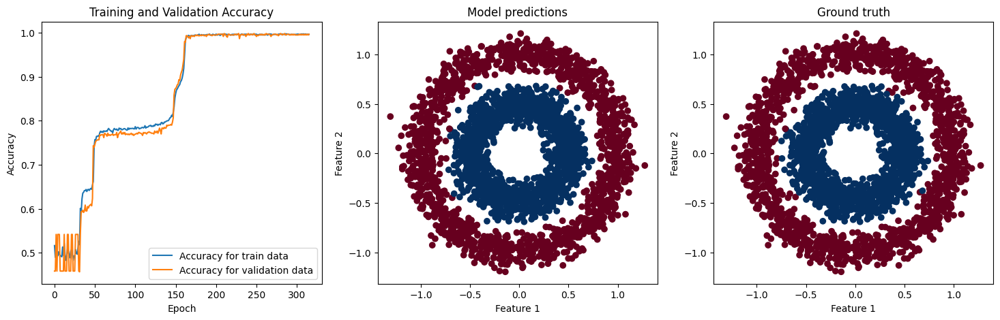

Test loss:  0.009590870700776577
Test accuracy:  0.9963333606719971
Model: "sequential_100"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_364 (Dense)           (None, 20)                60        
                                                                 
 dense_365 (Dense)           (None, 20)                420       
                                                                 
 dense_366 (Dense)           (None, 20)                420       
                                                                 
 dense_367 (Dense)           (None, 20)                420       
                                                                 
 dense_368 (Dense)           (None, 20)                420       
                                                                 
 dense_369 (Dense)           (None, 1)                 21        
                                                  

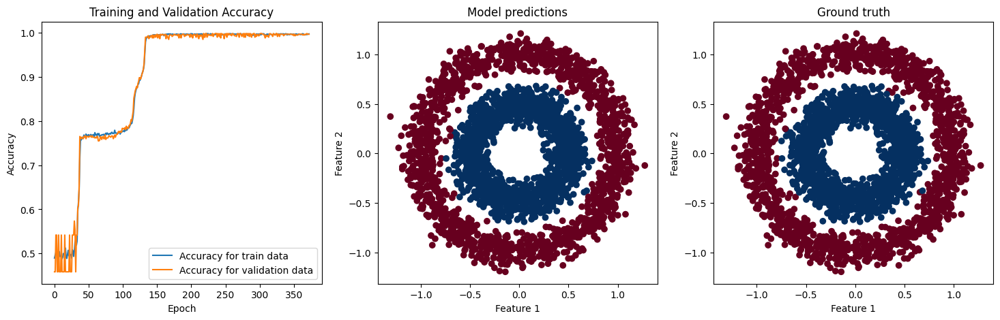

Test loss:  0.0091495206579566
Test accuracy:  0.996999979019165
Model: "sequential_101"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_370 (Dense)           (None, 20)                60        
                                                                 
 dense_371 (Dense)           (None, 20)                420       
                                                                 
 dense_372 (Dense)           (None, 20)                420       
                                                                 
 dense_373 (Dense)           (None, 20)                420       
                                                                 
 dense_374 (Dense)           (None, 20)                420       
                                                                 
 dense_375 (Dense)           (None, 1)                 21        
                                                     

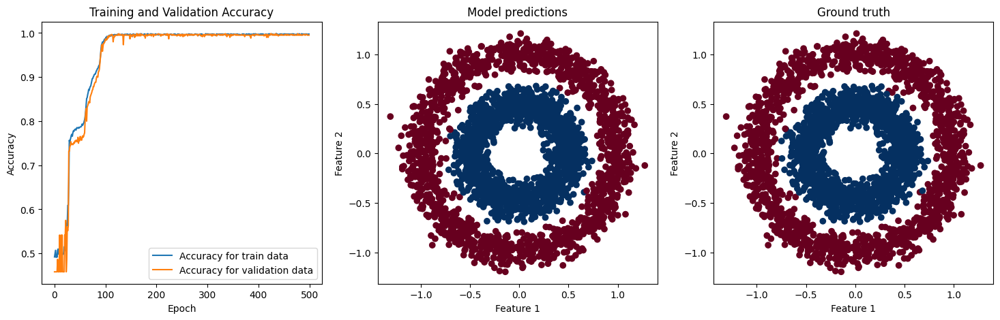

Test loss:  0.008734546601772308
Test accuracy:  0.9973333477973938
Model: "sequential_102"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_376 (Dense)           (None, 20)                60        
                                                                 
 dense_377 (Dense)           (None, 20)                420       
                                                                 
 dense_378 (Dense)           (None, 20)                420       
                                                                 
 dense_379 (Dense)           (None, 20)                420       
                                                                 
 dense_380 (Dense)           (None, 20)                420       
                                                                 
 dense_381 (Dense)           (None, 1)                 21        
                                                  

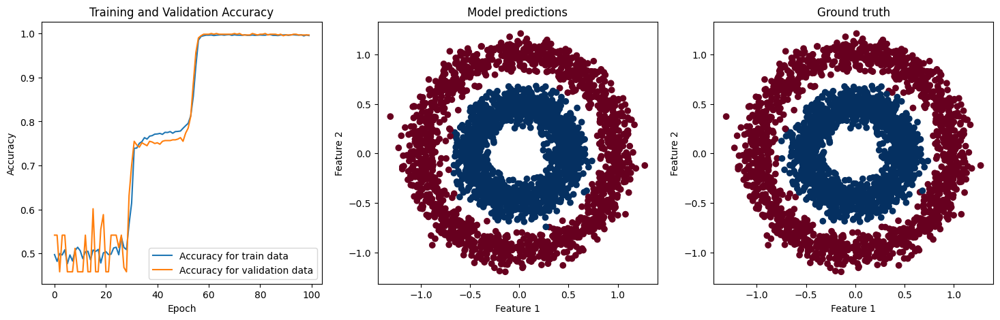

Test loss:  0.011523396708071232
Test accuracy:  0.9959999918937683
Model: "sequential_103"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_382 (Dense)           (None, 50)                150       
                                                                 
 dense_383 (Dense)           (None, 50)                2550      
                                                                 
 dense_384 (Dense)           (None, 50)                2550      
                                                                 
 dense_385 (Dense)           (None, 1)                 51        
                                                                 
Total params: 5301 (20.71 KB)
Trainable params: 5301 (20.71 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:

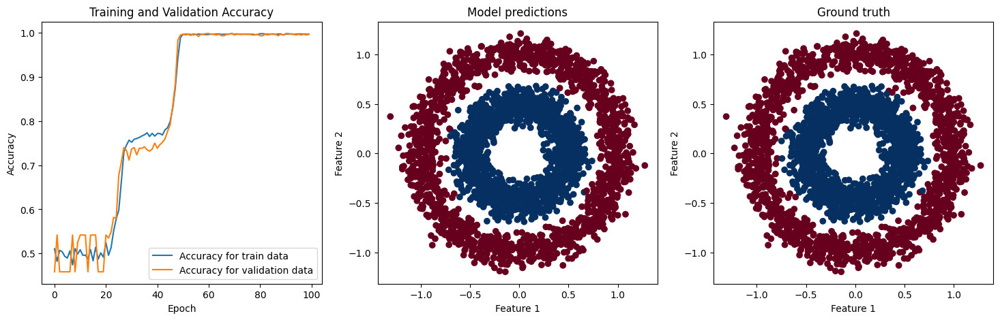

Test loss:  0.008700975216925144
Test accuracy:  0.996999979019165
Model: "sequential_104"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_386 (Dense)           (None, 50)                150       
                                                                 
 dense_387 (Dense)           (None, 50)                2550      
                                                                 
 dense_388 (Dense)           (None, 50)                2550      
                                                                 
 dense_389 (Dense)           (None, 1)                 51        
                                                                 
Total params: 5301 (20.71 KB)
Trainable params: 5301 (20.71 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons: 

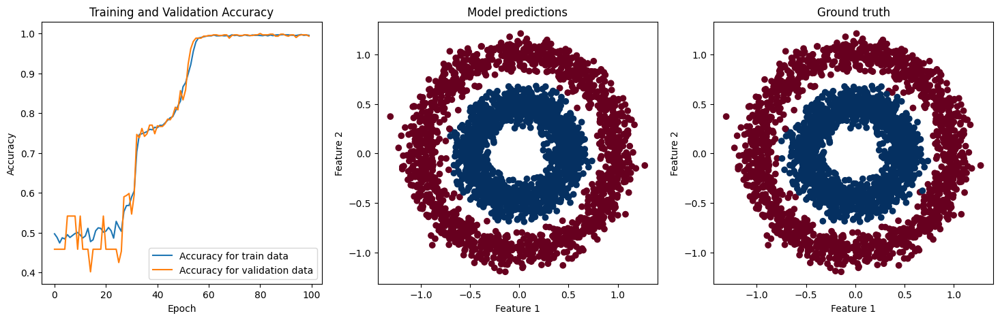

Test loss:  0.009581105783581734
Test accuracy:  0.9976666569709778
Model: "sequential_105"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_390 (Dense)           (None, 50)                150       
                                                                 
 dense_391 (Dense)           (None, 50)                2550      
                                                                 
 dense_392 (Dense)           (None, 50)                2550      
                                                                 
 dense_393 (Dense)           (None, 1)                 51        
                                                                 
Total params: 5301 (20.71 KB)
Trainable params: 5301 (20.71 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:

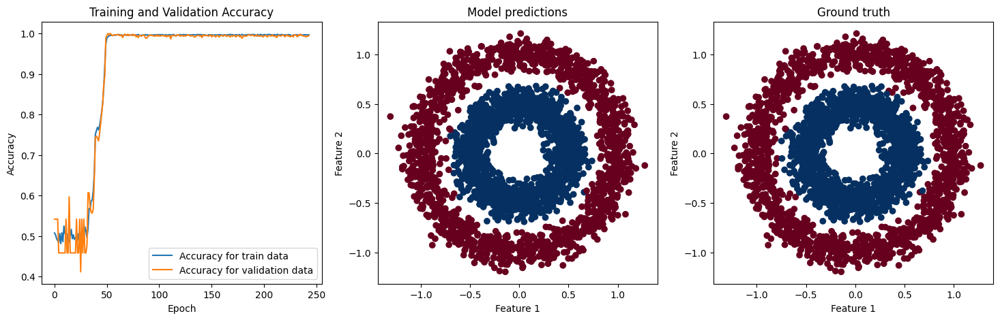

Test loss:  0.006307720672339201
Test accuracy:  0.996666669845581
Model: "sequential_106"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_394 (Dense)           (None, 50)                150       
                                                                 
 dense_395 (Dense)           (None, 50)                2550      
                                                                 
 dense_396 (Dense)           (None, 50)                2550      
                                                                 
 dense_397 (Dense)           (None, 1)                 51        
                                                                 
Total params: 5301 (20.71 KB)
Trainable params: 5301 (20.71 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons: 

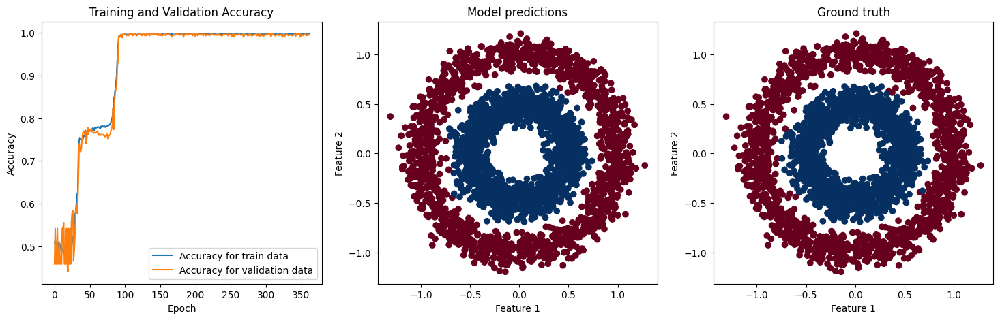

Test loss:  0.00798816792666912
Test accuracy:  0.9963333606719971
Model: "sequential_107"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_398 (Dense)           (None, 50)                150       
                                                                 
 dense_399 (Dense)           (None, 50)                2550      
                                                                 
 dense_400 (Dense)           (None, 50)                2550      
                                                                 
 dense_401 (Dense)           (None, 1)                 51        
                                                                 
Total params: 5301 (20.71 KB)
Trainable params: 5301 (20.71 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons: 

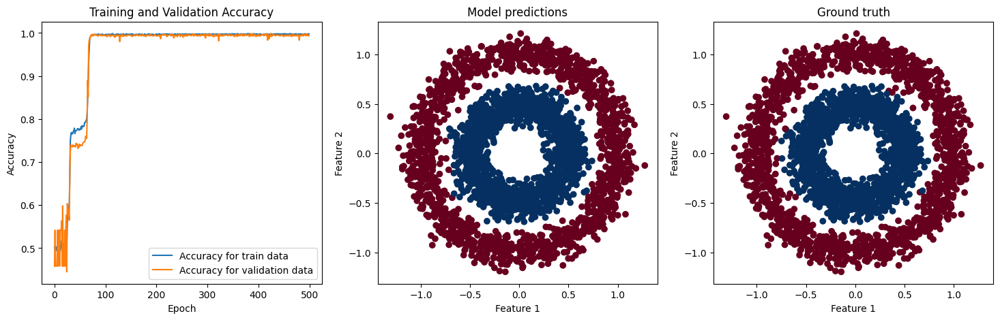

Test loss:  0.007558458484709263
Test accuracy:  0.996666669845581
Model: "sequential_108"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_402 (Dense)           (None, 50)                150       
                                                                 
 dense_403 (Dense)           (None, 50)                2550      
                                                                 
 dense_404 (Dense)           (None, 50)                2550      
                                                                 
 dense_405 (Dense)           (None, 1)                 51        
                                                                 
Total params: 5301 (20.71 KB)
Trainable params: 5301 (20.71 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons: 

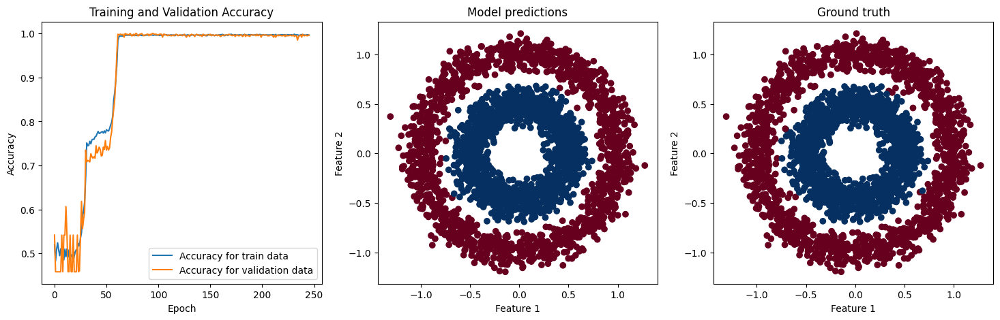

Test loss:  0.006098158657550812
Test accuracy:  0.9973333477973938
Model: "sequential_109"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_406 (Dense)           (None, 50)                150       
                                                                 
 dense_407 (Dense)           (None, 50)                2550      
                                                                 
 dense_408 (Dense)           (None, 50)                2550      
                                                                 
 dense_409 (Dense)           (None, 1)                 51        
                                                                 
Total params: 5301 (20.71 KB)
Trainable params: 5301 (20.71 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons:

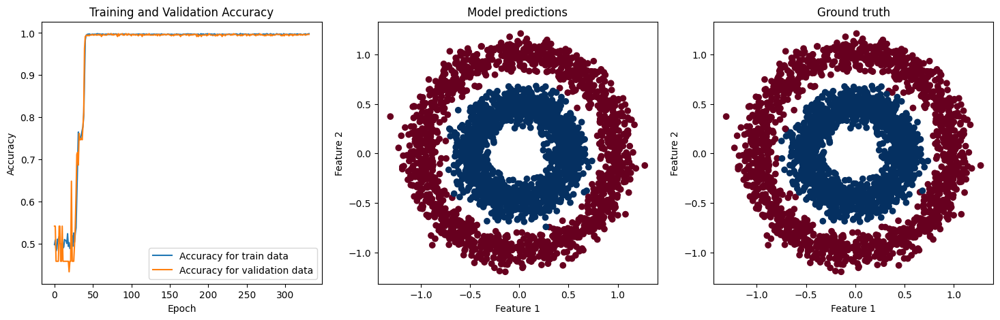

Test loss:  0.007476550992578268
Test accuracy:  0.996666669845581
Model: "sequential_110"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_410 (Dense)           (None, 50)                150       
                                                                 
 dense_411 (Dense)           (None, 50)                2550      
                                                                 
 dense_412 (Dense)           (None, 50)                2550      
                                                                 
 dense_413 (Dense)           (None, 1)                 51        
                                                                 
Total params: 5301 (20.71 KB)
Trainable params: 5301 (20.71 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons: 

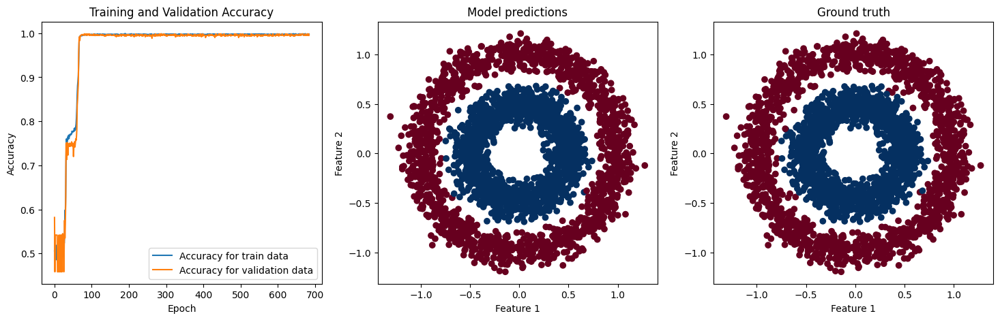

Test loss:  0.009077325463294983
Test accuracy:  0.996999979019165
Model: "sequential_111"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_414 (Dense)           (None, 50)                150       
                                                                 
 dense_415 (Dense)           (None, 50)                2550      
                                                                 
 dense_416 (Dense)           (None, 50)                2550      
                                                                 
 dense_417 (Dense)           (None, 1)                 51        
                                                                 
Total params: 5301 (20.71 KB)
Trainable params: 5301 (20.71 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Model summary:  None
------------------------------------------
Number of neurons: 

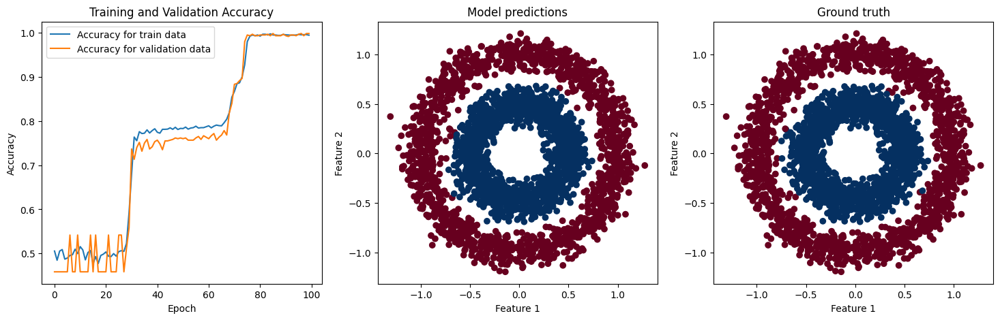

Test loss:  0.011616373434662819
Test accuracy:  0.996666669845581
Model: "sequential_112"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_418 (Dense)           (None, 50)                150       
                                                                 
 dense_419 (Dense)           (None, 50)                2550      
                                                                 
 dense_420 (Dense)           (None, 50)                2550      
                                                                 
 dense_421 (Dense)           (None, 50)                2550      
                                                                 
 dense_422 (Dense)           (None, 1)                 51        
                                                                 
Total params: 7851 (30.67 KB)
Trainable params: 7851 (30.67 KB)
Non-trainable params: 0 (0.00 Byte)
_________________

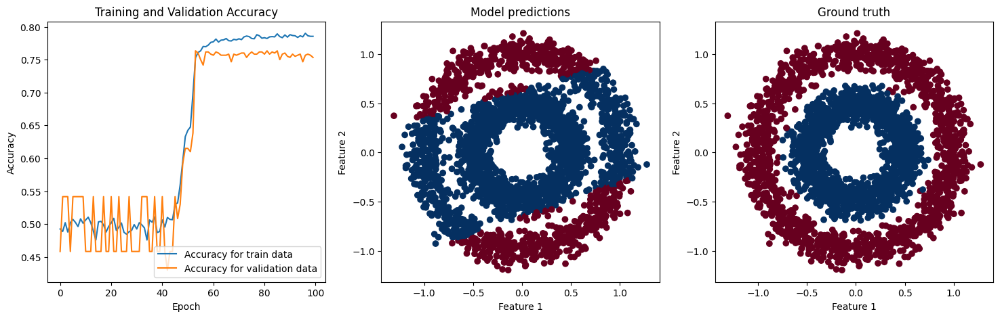

Test loss:  0.45975223183631897
Test accuracy:  0.7730000019073486
Model: "sequential_113"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_423 (Dense)           (None, 50)                150       
                                                                 
 dense_424 (Dense)           (None, 50)                2550      
                                                                 
 dense_425 (Dense)           (None, 50)                2550      
                                                                 
 dense_426 (Dense)           (None, 50)                2550      
                                                                 
 dense_427 (Dense)           (None, 1)                 51        
                                                                 
Total params: 7851 (30.67 KB)
Trainable params: 7851 (30.67 KB)
Non-trainable params: 0 (0.00 Byte)
_________________

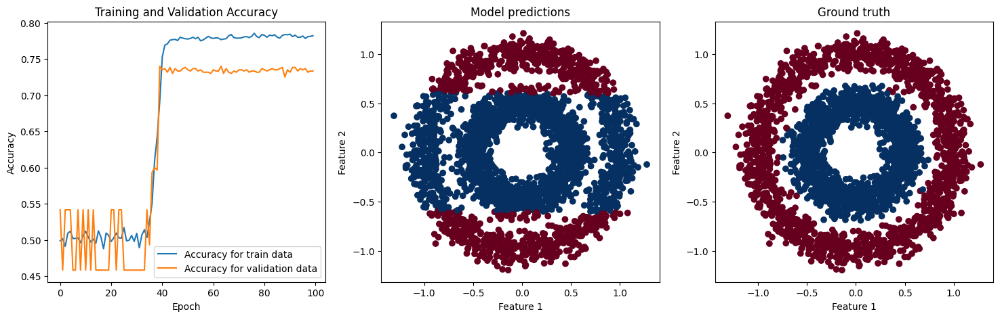

Test loss:  0.45525842905044556
Test accuracy:  0.7796666622161865
Model: "sequential_114"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_428 (Dense)           (None, 50)                150       
                                                                 
 dense_429 (Dense)           (None, 50)                2550      
                                                                 
 dense_430 (Dense)           (None, 50)                2550      
                                                                 
 dense_431 (Dense)           (None, 50)                2550      
                                                                 
 dense_432 (Dense)           (None, 1)                 51        
                                                                 
Total params: 7851 (30.67 KB)
Trainable params: 7851 (30.67 KB)
Non-trainable params: 0 (0.00 Byte)
_________________

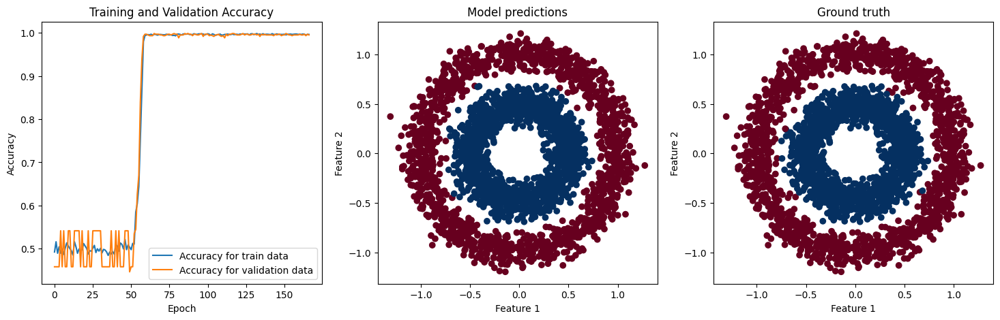

Test loss:  0.008097863756120205
Test accuracy:  0.9963333606719971
Model: "sequential_115"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_433 (Dense)           (None, 50)                150       
                                                                 
 dense_434 (Dense)           (None, 50)                2550      
                                                                 
 dense_435 (Dense)           (None, 50)                2550      
                                                                 
 dense_436 (Dense)           (None, 50)                2550      
                                                                 
 dense_437 (Dense)           (None, 1)                 51        
                                                                 
Total params: 7851 (30.67 KB)
Trainable params: 7851 (30.67 KB)
Non-trainable params: 0 (0.00 Byte)
________________

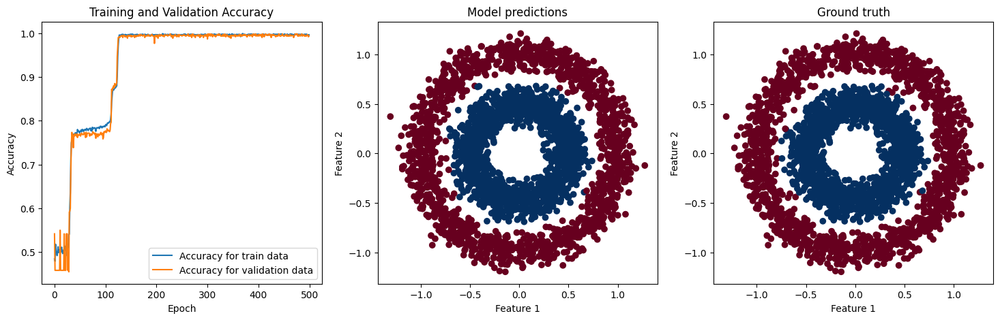

Test loss:  0.012455137446522713
Test accuracy:  0.9956666827201843
Model: "sequential_116"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_438 (Dense)           (None, 50)                150       
                                                                 
 dense_439 (Dense)           (None, 50)                2550      
                                                                 
 dense_440 (Dense)           (None, 50)                2550      
                                                                 
 dense_441 (Dense)           (None, 50)                2550      
                                                                 
 dense_442 (Dense)           (None, 1)                 51        
                                                                 
Total params: 7851 (30.67 KB)
Trainable params: 7851 (30.67 KB)
Non-trainable params: 0 (0.00 Byte)
________________

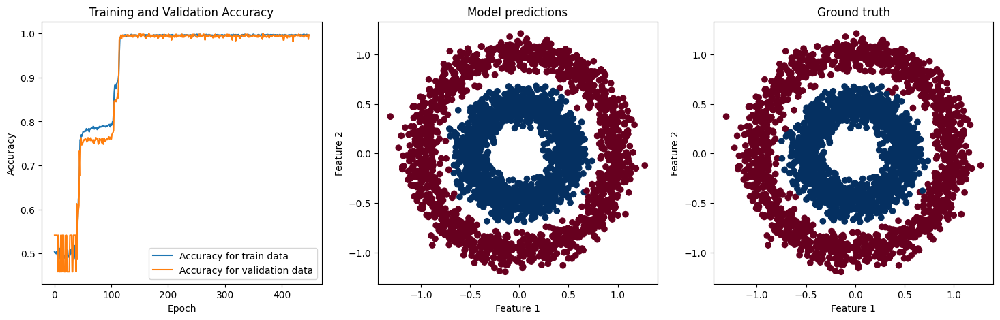

Test loss:  0.006428445223718882
Test accuracy:  0.996666669845581
Model: "sequential_117"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_443 (Dense)           (None, 50)                150       
                                                                 
 dense_444 (Dense)           (None, 50)                2550      
                                                                 
 dense_445 (Dense)           (None, 50)                2550      
                                                                 
 dense_446 (Dense)           (None, 50)                2550      
                                                                 
 dense_447 (Dense)           (None, 1)                 51        
                                                                 
Total params: 7851 (30.67 KB)
Trainable params: 7851 (30.67 KB)
Non-trainable params: 0 (0.00 Byte)
_________________

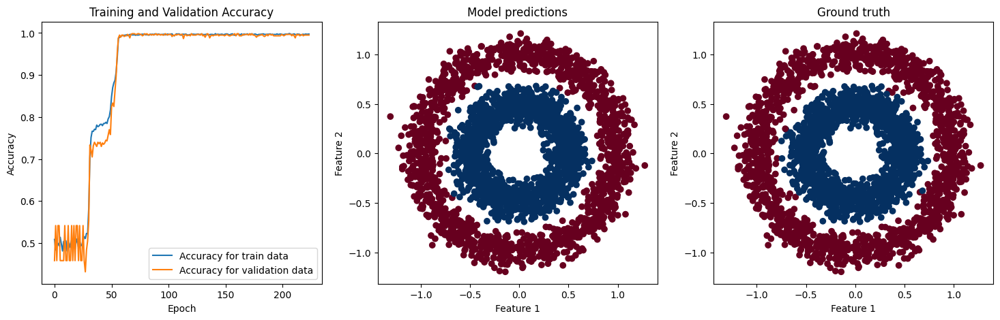

Test loss:  0.00926198624074459
Test accuracy:  0.9959999918937683
Model: "sequential_118"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_448 (Dense)           (None, 50)                150       
                                                                 
 dense_449 (Dense)           (None, 50)                2550      
                                                                 
 dense_450 (Dense)           (None, 50)                2550      
                                                                 
 dense_451 (Dense)           (None, 50)                2550      
                                                                 
 dense_452 (Dense)           (None, 1)                 51        
                                                                 
Total params: 7851 (30.67 KB)
Trainable params: 7851 (30.67 KB)
Non-trainable params: 0 (0.00 Byte)
_________________

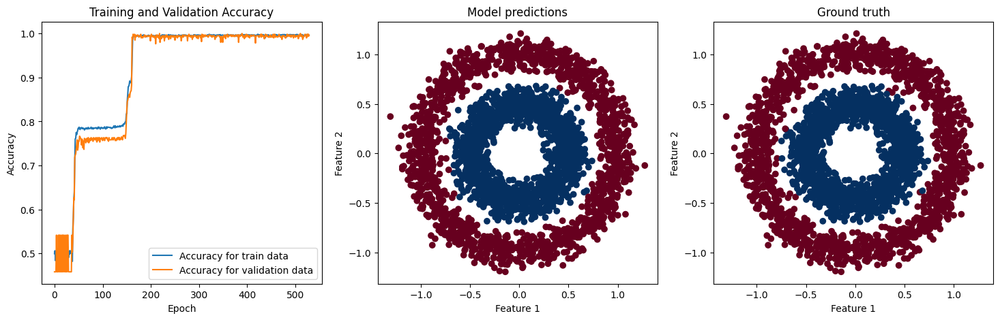

Test loss:  0.0060060215182602406
Test accuracy:  0.996666669845581
Model: "sequential_119"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_453 (Dense)           (None, 50)                150       
                                                                 
 dense_454 (Dense)           (None, 50)                2550      
                                                                 
 dense_455 (Dense)           (None, 50)                2550      
                                                                 
 dense_456 (Dense)           (None, 50)                2550      
                                                                 
 dense_457 (Dense)           (None, 1)                 51        
                                                                 
Total params: 7851 (30.67 KB)
Trainable params: 7851 (30.67 KB)
Non-trainable params: 0 (0.00 Byte)
________________

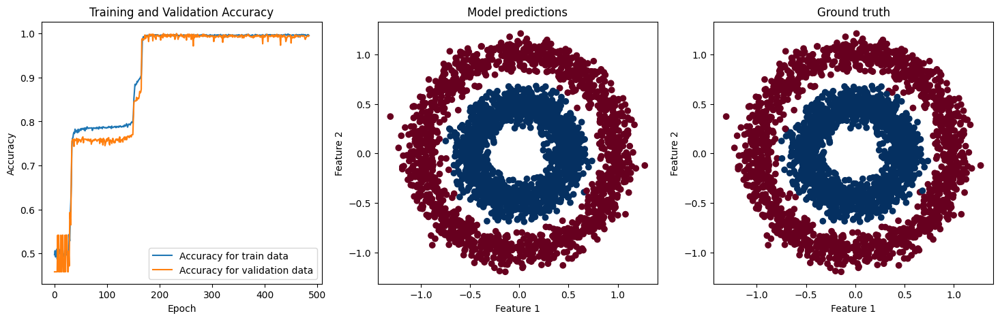

Test loss:  0.00639747641980648
Test accuracy:  0.9973333477973938
Model: "sequential_120"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_458 (Dense)           (None, 50)                150       
                                                                 
 dense_459 (Dense)           (None, 50)                2550      
                                                                 
 dense_460 (Dense)           (None, 50)                2550      
                                                                 
 dense_461 (Dense)           (None, 50)                2550      
                                                                 
 dense_462 (Dense)           (None, 1)                 51        
                                                                 
Total params: 7851 (30.67 KB)
Trainable params: 7851 (30.67 KB)
Non-trainable params: 0 (0.00 Byte)
_________________

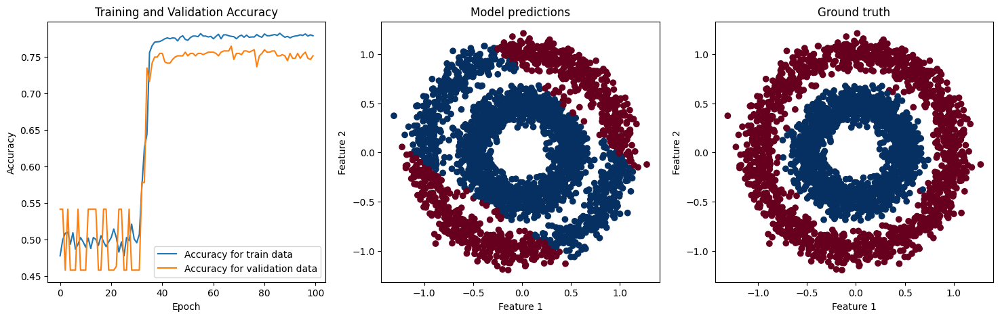

Test loss:  0.4606325328350067
Test accuracy:  0.7749999761581421
Model: "sequential_121"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_463 (Dense)           (None, 50)                150       
                                                                 
 dense_464 (Dense)           (None, 50)                2550      
                                                                 
 dense_465 (Dense)           (None, 50)                2550      
                                                                 
 dense_466 (Dense)           (None, 50)                2550      
                                                                 
 dense_467 (Dense)           (None, 50)                2550      
                                                                 
 dense_468 (Dense)           (None, 1)                 51        
                                                    

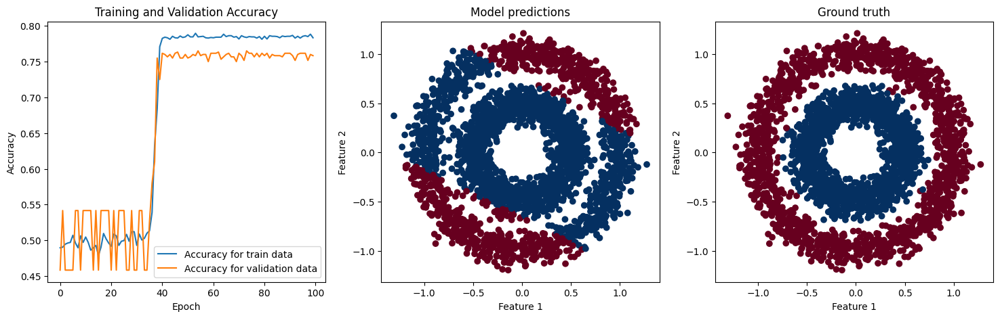

Test loss:  0.46922966837882996
Test accuracy:  0.7643333077430725
Model: "sequential_122"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_469 (Dense)           (None, 50)                150       
                                                                 
 dense_470 (Dense)           (None, 50)                2550      
                                                                 
 dense_471 (Dense)           (None, 50)                2550      
                                                                 
 dense_472 (Dense)           (None, 50)                2550      
                                                                 
 dense_473 (Dense)           (None, 50)                2550      
                                                                 
 dense_474 (Dense)           (None, 1)                 51        
                                                   

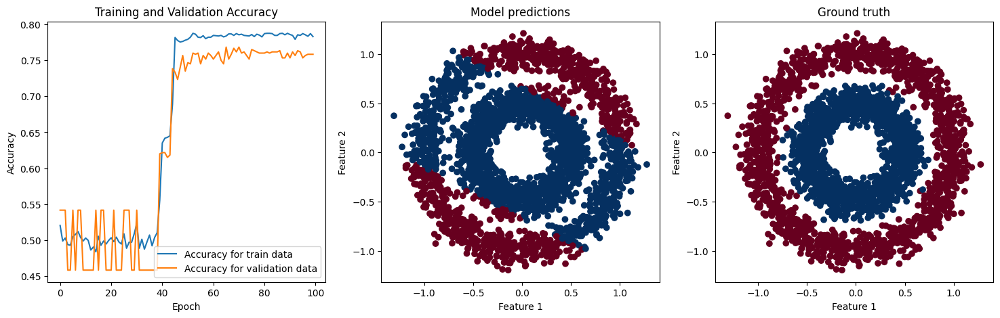

Test loss:  0.46143871545791626
Test accuracy:  0.7753333449363708
Model: "sequential_123"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_475 (Dense)           (None, 50)                150       
                                                                 
 dense_476 (Dense)           (None, 50)                2550      
                                                                 
 dense_477 (Dense)           (None, 50)                2550      
                                                                 
 dense_478 (Dense)           (None, 50)                2550      
                                                                 
 dense_479 (Dense)           (None, 50)                2550      
                                                                 
 dense_480 (Dense)           (None, 1)                 51        
                                                   

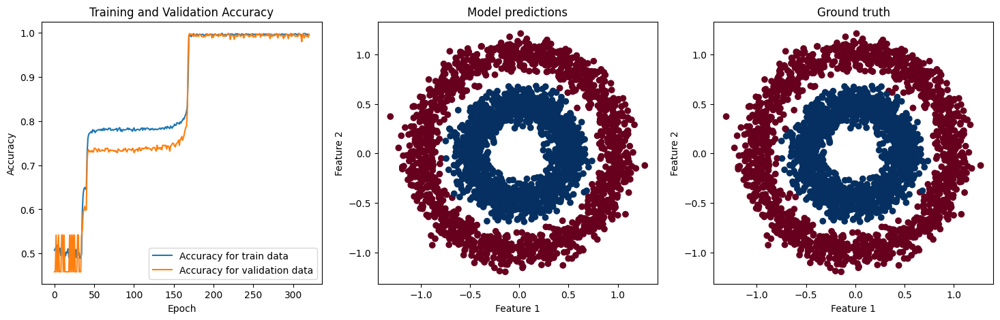

Test loss:  0.007359399925917387
Test accuracy:  0.9976666569709778
Model: "sequential_124"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_481 (Dense)           (None, 50)                150       
                                                                 
 dense_482 (Dense)           (None, 50)                2550      
                                                                 
 dense_483 (Dense)           (None, 50)                2550      
                                                                 
 dense_484 (Dense)           (None, 50)                2550      
                                                                 
 dense_485 (Dense)           (None, 50)                2550      
                                                                 
 dense_486 (Dense)           (None, 1)                 51        
                                                  

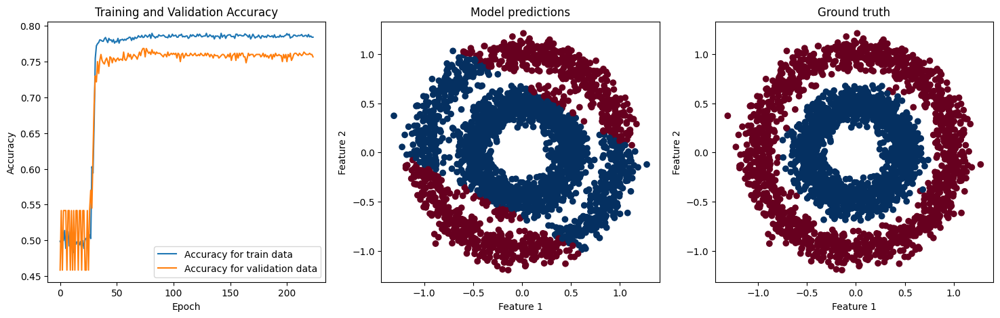

Test loss:  0.46000245213508606
Test accuracy:  0.7730000019073486
Model: "sequential_125"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_487 (Dense)           (None, 50)                150       
                                                                 
 dense_488 (Dense)           (None, 50)                2550      
                                                                 
 dense_489 (Dense)           (None, 50)                2550      
                                                                 
 dense_490 (Dense)           (None, 50)                2550      
                                                                 
 dense_491 (Dense)           (None, 50)                2550      
                                                                 
 dense_492 (Dense)           (None, 1)                 51        
                                                   

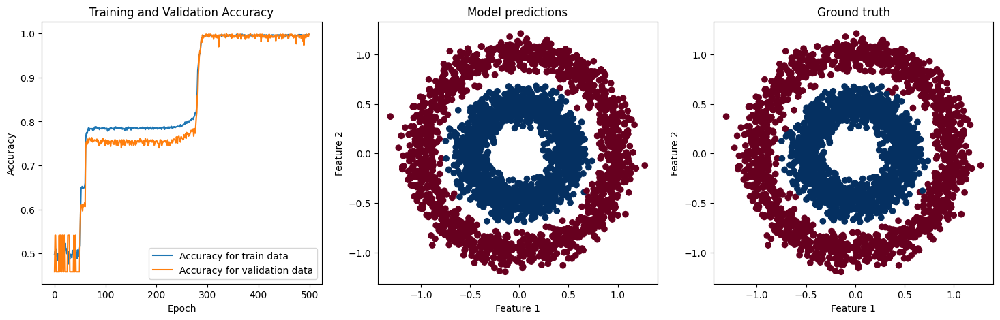

Test loss:  0.007545534987002611
Test accuracy:  0.9976666569709778
Model: "sequential_126"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_493 (Dense)           (None, 50)                150       
                                                                 
 dense_494 (Dense)           (None, 50)                2550      
                                                                 
 dense_495 (Dense)           (None, 50)                2550      
                                                                 
 dense_496 (Dense)           (None, 50)                2550      
                                                                 
 dense_497 (Dense)           (None, 50)                2550      
                                                                 
 dense_498 (Dense)           (None, 1)                 51        
                                                  

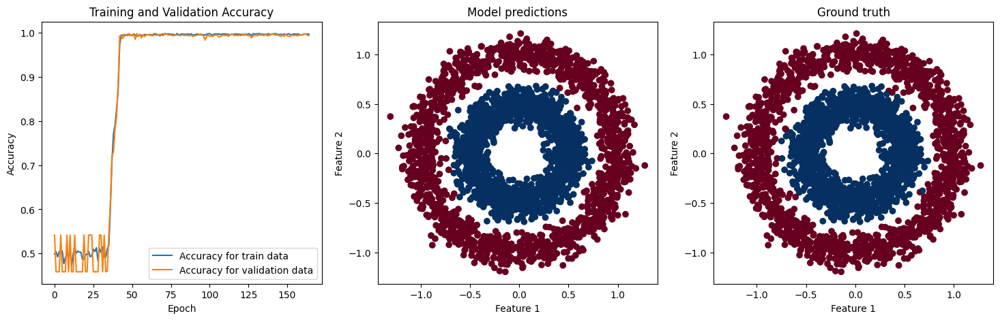

Test loss:  0.006066781468689442
Test accuracy:  0.996999979019165
Model: "sequential_127"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_499 (Dense)           (None, 50)                150       
                                                                 
 dense_500 (Dense)           (None, 50)                2550      
                                                                 
 dense_501 (Dense)           (None, 50)                2550      
                                                                 
 dense_502 (Dense)           (None, 50)                2550      
                                                                 
 dense_503 (Dense)           (None, 50)                2550      
                                                                 
 dense_504 (Dense)           (None, 1)                 51        
                                                   

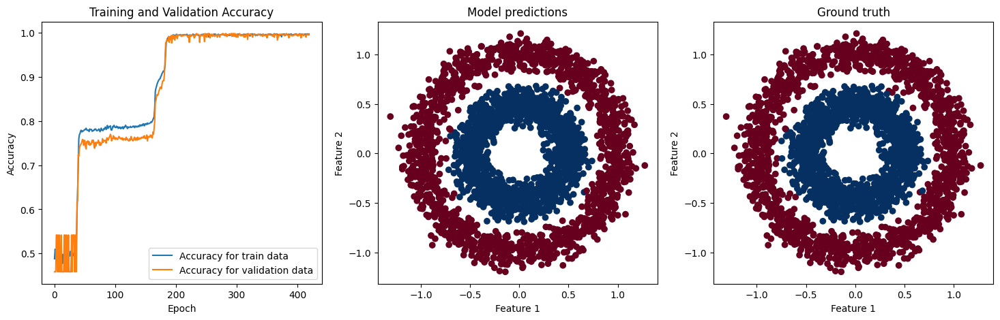

Test loss:  0.0068986378610134125
Test accuracy:  0.996999979019165
Model: "sequential_128"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_505 (Dense)           (None, 50)                150       
                                                                 
 dense_506 (Dense)           (None, 50)                2550      
                                                                 
 dense_507 (Dense)           (None, 50)                2550      
                                                                 
 dense_508 (Dense)           (None, 50)                2550      
                                                                 
 dense_509 (Dense)           (None, 50)                2550      
                                                                 
 dense_510 (Dense)           (None, 1)                 51        
                                                  

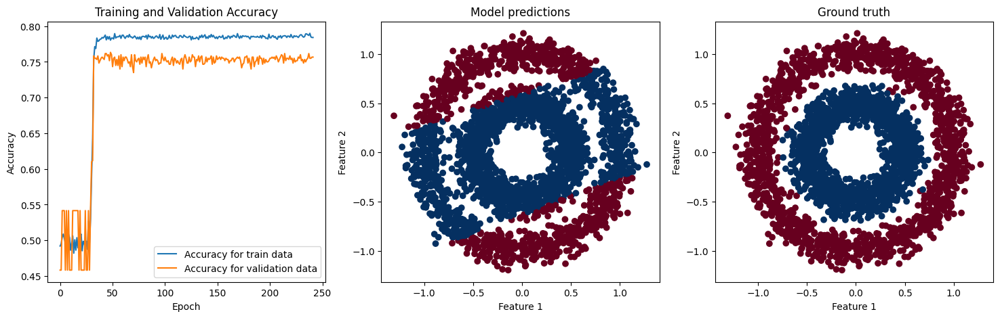

Test loss:  0.4616134464740753
Test accuracy:  0.7720000147819519
Model: "sequential_129"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_511 (Dense)           (None, 50)                150       
                                                                 
 dense_512 (Dense)           (None, 50)                2550      
                                                                 
 dense_513 (Dense)           (None, 50)                2550      
                                                                 
 dense_514 (Dense)           (None, 50)                2550      
                                                                 
 dense_515 (Dense)           (None, 50)                2550      
                                                                 
 dense_516 (Dense)           (None, 1)                 51        
                                                    

KeyboardInterrupt: 

In [19]:
list_of_num_neurons = [ 20, 50, 1000]
list_of_num_layers = [ 3, 4, 5]
list_of_num_epochs = [100, 500, 1000]
list_of_patience = [50, 100, 200]

for num_neurons in list_of_num_neurons:
    for num_layers in list_of_num_layers:
        for num_epochs in list_of_num_epochs:
            for patience in list_of_patience:
                print('Number of neurons: ', num_neurons)
                print('Number of layers: ', num_layers)
                print('Number of epochs: ', num_epochs)
                print('Patience: ', patience)
                model = build_model(num_layers=num_layers, num_neurons=num_neurons)
                train_and_evaluate_model(model, epochs=num_epochs, plot=True, patience=patience)
                print('------------------------------------------')